In [1]:
# Print out WSL shell environment vars passed to jupyter notebook
ENV

Base.EnvDict with 30 entries:
  "SHELL"           => "/bin/bash"
  "WSL_DISTRO_NAME" => "Ubuntu"
  "WT_SESSION"      => "cdc049b6-5926-4fe8-8fb9-235d5b7e03b6"
  "NAME"            => "DESKTOP-A1AUCQ6"
  "PWD"             => "/home/kkganko/oscillatory_bioreactor"
  "LOGNAME"         => "kkganko"
  "MOTD_SHOWN"      => "update-motd"
  "HOME"            => "/home/kkganko"
  "LANG"            => "C.UTF-8"
  "WSL_INTEROP"     => "/run/WSL/8_interop"
  "LS_COLORS"       => "rs=0:di=01;34:ln=01;36:mh=00:pi=40;33:so=01;35:do=01;35…
  "LESSCLOSE"       => "/usr/bin/lesspipe %s %s"
  "PYTHONPATH"      => "/home/kkganko/.julia/conda/3/bin/python"
  "TERM"            => "xterm-256color"
  "LESSOPEN"        => "| /usr/bin/lesspipe %s"
  "USER"            => "kkganko"
  "SHLVL"           => "1"
  "DOCKER_ARCH"     => "amd64"
  "WSLENV"          => "WT_SESSION::WT_PROFILE_ID"
  "XDG_DATA_DIRS"   => "/usr/local/share:/usr/share:/var/lib/snapd/desktop"
  "BROWSER"         => "/mnt/c/Program Files (x86)/

In [2]:
import Pkg; Pkg.status()

      Status `~/.julia/environments/v1.7/Project.toml`
  [6e4b80f9] BenchmarkTools v1.3.1
  [8f4d0f93] Conda v1.7.0
  [459566f4] DiffEqCallbacks v2.26.1
  [7073ff75] IJulia v1.23.3
  [4138dd39] JLD v0.13.2
  [b964fa9f] LaTeXStrings v1.3.0
  [1dea7af3] OrdinaryDiffEq v6.51.2
  [91a5bcdd] Plots v1.31.7
  [438e738f] PyCall v1.94.1
  [d330b81b] PyPlot v2.11.0
  [274fc56d] PythonPlot v1.0.2
  [731186ca] RecursiveArrayTools v2.38.5
  [276daf66] SpecialFunctions v2.1.7
  [c3572dad] Sundials v4.19.0


In [332]:
# Pkg.add("IJulia")
# Pkg.add("Conda")
# Pkg.add("PyCall")
# Pkg.add("Plots")
# Pkg.add("PyPlot")
# Pkg.add("PythonPlot") # a fork from PyPlot.jl, newer and better, https://github.com/JuliaPy/PythonPlot.jl
# Pkg.add("JLD") # for loading and saving Julia variables using .jld file format
# Pkg.add("LaTeXStrings") # for using latex math fonts in plots, prepend L to strings, ie. L"5+5"
# Pkg.add("SpecialFunctions") # for getting Beta function and error function + complementary error function values given inputs
# Pkg.add("BenchmarkTools") # for performance tracking, https://github.com/JuliaCI/BenchmarkTools.jl
# Pkg.add("OrdinaryDiffEq") # for just the ODE numerical solvers in DifferentialEquations.jl
# Pkg.add("DiffEqCallbacks") # for saving callback
# Pkg.add("Sundials") # for large scale DAE simulation IDA method
# Pkg.add("JLD") # for loading and saving Julia variables using .jld file format

# post-processing for pkg.add, might need to update packages, see:
# https://stackoverflow.com/questions/57639110/julia-how-to-update-to-the-latest-version-of-a-package-i-e-flux
# Pkg.update("OrdinaryDiffEq") # `using OrdinarryDiffEq` causes LoadError: UndefVarError: AbstractDiffEqLinearOperator not defined
# # afterwards, got ERROR: LoadError: UndefVarError: Size not defined ==> need to reload Julia ipynb

# need to use the packages, i.e., this starts the precompilation and is the most probable failure point
using Printf # for pretty string formatting of variables
using Random # for setting random seeds
using IJulia
using Conda
using PyCall
using Plots; pyplot(html_output_format=:png)
using JLD
using LaTeXStrings
using SpecialFunctions
using LinearAlgebra # holds LowerTriangular() matrix generator plus other nifty Linpack routines
using BenchmarkTools
using OrdinaryDiffEq
using DiffEqCallbacks
# using PythonPlot # keeps crashing the kernel, unfortunately
using Sundials
using JLD # for saving and loading Julia variables in .jld format

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.7/Project.toml`
  No Changes to `~/.julia/environments/v1.7/Manifest.toml`


1×3 Matrix{String}:
 "hi"  "hi"  "hi"

0.07
$5+5$
$\mathrm{My\, \alpha\, including\, a\, variable\, date:\,}07-08-2018$


L"$\textrm{My date is } 07-08-2018$"

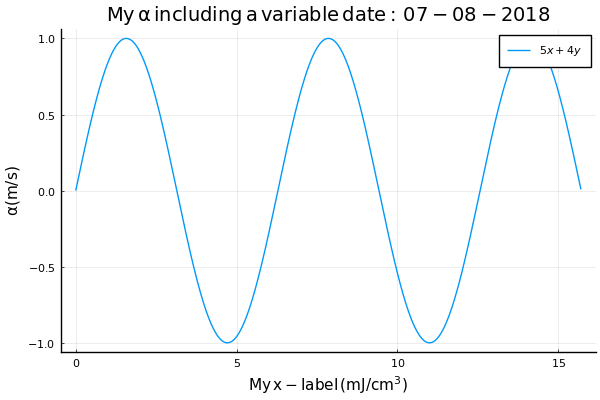

In [4]:
# Test if normal commands are working in this notebook
display("text/plain", ["hi" "hi" "hi"])
Random.seed!(1) # set random seed for runs going forward
testtest = rand() # should be reproducible random number at this point
actual_label = "$(@sprintf("%.2f", testtest))" # pretty formatting
println(actual_label)

# Test if Latex is working fine, can either prepend L to strings or use latexstring function (PREFERRED).
# NOT WORKING IN GR()! See more discussion about issues with gr() backend at 
# https://discourse.julialang.org/t/latex-code-for-titles-labels-with-plots-jl/1967/17
println(L"5+5")
date = "07-08-2018"
titlestring = latexstring("\\mathrm{My\\, \\alpha\\, including\\, a\\, variable\\, date:\\,}", date)
println(titlestring)
display(L"\textrm{My date is } %$(date)")
plot(sin, (0:0.01:5*pi), title = titlestring, xlabel = L"\mathrm{My\, x-label\, (mJ/cm^{3})}", 
    ylabel = L"\mathrm{\alpha (m/s)}", label = latexstring("5x+4y"))

In [342]:
pwd() * "/TestTest.jld"

"/home/kkganko/oscillatory_bioreactor/yeast_PBM/TestTest.jld"

In [343]:
# Usage of file I/O via JLD.jl
jld_fp = pwd() * "/TestTest.jld"
a = Dict{String, Array}("A"=>[1,23], "B"=>[5.5,2], "15"=>[0;0;0])

jldopen(jld_fp, "w") do file
    write(file, "a", a)  # alternatively, say "@write file a"
end

c = jldopen(jld_fp, "r") do file
    read(file, "a")
end
display(c)
rm(jld_fp)

Dict{String, Array} with 3 entries:
  "B"  => [5.5, 2.0]
  "A"  => [1, 23]
  "15" => [0, 0, 0]

# See v1 file for description of system and less numerically robust system for open-loop simulations.

# The v2 file carries more numerically robust system for open and closed-loop simulation

In [18]:
D_control(t,t1=20.0,t2=50.0,t3=100.0,t4=130.0) = 
    0.21*(t>=0.0 && t<t1) + 
    ((t-t1)*(0.18-0.21)/(t2-t1)+0.21)*(t>=t1 && t<t2) +
    0.18*(t>=t2 && t<t3) +
    ((t-t3)*(0.21-0.18)/(t4-t3)+0.18)*(t>=t3 && t<t4) +
    0.21*(t>=t4)

D_control (generic function with 5 methods)

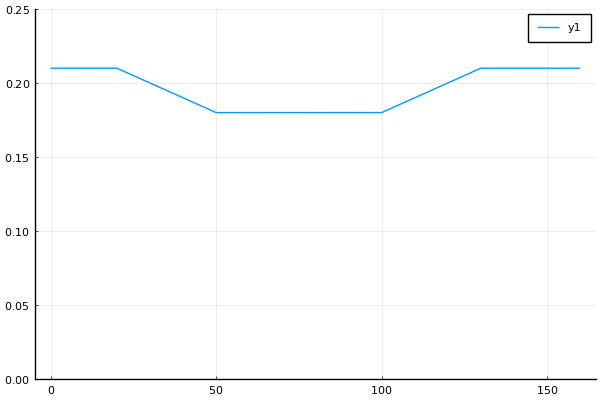

In [19]:
t_list = collect(range(0.0,160.0,500))
plot(
    t_list,
    D_control.(t_list),
    ylim = (0.0,0.25)
)

In [428]:
# wrapper for PyClaw routine
py"""
# import relevant packages
import numpy as np
from scipy.stats import norm
from scipy.special import erf
from scipy.special import beta

from clawpack import pyclaw
from clawpack import riemann

# define helper functions
N_pdf_py = lambda x,mu,sigma : norm.pdf(x, loc = mu, scale = sigma)
midpt_trapz = lambda delx_list,y_c : np.dot(delx_list,y_c)
k_m = lambda S_prime, μ_m, K_m: (μ_m * S_prime)/(K_m + S_prime)

# define for both transition mass and critical mass
def m_td(S_prime,m_td0,K_td,S_l,S_h):
    if S_prime < S_l:
        return m_td0 + K_td*(S_l - S_h)
    elif (S_prime > S_l) and (S_prime < S_h):
        return m_td0 + K_td*(S_prime - S_h)
    else:
        return m_td0

# define fission rate function
@np.vectorize
def Γ(m,γ,ϵ,m_t,m_d,m_a):
    if m < m_t+m_a:
        return 0.0
    elif (m > m_t+m_a) and (m < m_d):
        return γ*np.exp(-ϵ*(m-m_d)**2)
    else:
        return γ

# partition function
def p_mm(m,m_prime,m_t,m_a,A,β):
    if m > m_prime:
        return 0.0
    elif m_prime < (m_t + m_a):
        return 0.0
    else:
        # full expression produces overflow errors, maybe do post-processing
        # A*(np.exp(β*(m-m_t)**2)+np.exp(β*(m-m_prime+m_t)**2))
        # turns out Hensen paper had typos!! should have negative sign in front of β's
        return A*(np.exp(-β*(m-m_t)**2)+np.exp(-β*(m-m_prime+m_t)**2))

def kernel_mat(m_list, N_m, m_t, m_a, A, β, Γ):

    p_mm_mat = np.zeros((N_m,N_m))

    for j in np.arange(0,N_m):
        for i in np.arange(0,N_m):
            p_mm_mat[j,i] = p_mm(m = m_list[i], m_prime = m_list[j], m_t=m_t, m_a=m_a, A=A, β=β)
    
    # np.multiply is an element-wise multiplication of the two input arrays, i.e., explicit broadcasting
    kernel_m = np.multiply(np.outer(Γ, np.ones(N_m)), p_mm_mat) # mother cell info on columns
    return kernel_m

# for generating the RHS of the solver, but also fed directly to solver
def dq_linhom_src(solver,state,dt):
    
    N_mt = state.q[0,:]
    Γ = state.aux[0,:] # Γ
    mc = state.grid.m.centers
    del_mc_list = np.multiply(np.ones(len(mc)), (mc[1]-mc[0]))

    # compute integral expression
    F = np.zeros(state.problem_data['N_m'])
    for i in range(1,state.problem_data['N_m']+1):
        F[i-1] = midpt_trapz(del_mc_list, np.multiply(state.aux[i,:], N_mt))

    # compute full RHS source term
    dq = np.empty(state.q.shape)
    D = state.problem_data['D']
    dq[0,:] = dt * (-(D + Γ) * N_mt + 2.0 * F)   
    return dq

def step_yeast_PBM_v1(S_prime, p_PBE, N_IC, dt):

    γ = p_PBE[0]                   # 1/hr, maximum fission rate, when cell m ≥ m_d
    A = p_PBE[1]                   # 1/g, partition function exponential prefactors (i.e., p(m,m'))
    S_l = p_PBE[2]                 # g/L, low substrate limit
    K_t = p_PBE[3]                 # g/g/L, proportionality constant for change in transition mass with substrate levels
    m_t0 = p_PBE[4]                # g, initial transition mass (at low substrate levels)
    m_max = p_PBE[5]               # g, maximal cell mass allowed
    Y = p_PBE[6]                   # g/g, yield coefficient for cell mass to mols substrate
    K_m = p_PBE[7]                 # g/L, Monod constant for single cell growth rate
    D = p_PBE[8]                   # 1/h, dilution rate in continuous bioreactor operation
    ϵ = p_PBE[9]                   # g^{-2}, inverse variance for fission rate when cells are in fissioning state
    β = p_PBE[10]                  # g^{-2}, another inverse variance for partition function
    S_h = p_PBE[11]                # g/L, high substrate limit
    K_d = p_PBE[12]                # g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
    m_d0 = p_PBE[13]               # g, initial critical fissioning mass (at low substrate levels)
    m_a = p_PBE[14]                # g, additional mass that mother cell must gain to start fissioning
    μ_m = p_PBE[15]                # g/h, single cell growth rate in limit of high substrate levels
    α = p_PBE[16]                  # 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
    S_f = p_PBE[17]                # g/L, feed concentration of substrate to continuous bioreactor
    N_m = int(p_PBE[18])           # number of grid points in mass domain
    
    # constant filtered substrate concentration
    m_t_test = m_td(S_prime, m_td0=m_t0, K_td=K_t, S_l=S_l, S_h=S_h)
    m_d_test = m_td(S_prime, m_td0=m_d0, K_td=K_d, S_l=S_l, S_h=S_h)
    m_ta_test = m_t_test + m_a

    # set up solver
    solver = pyclaw.SharpClawSolver1D(riemann.advection_1D_py.advection_1D)
    solver.kernel_language = 'Python'
    solver.weno_order = 5
    solver.time_integrator = 'SSP104'
    solver.dq_src = dq_linhom_src
    solver.bc_lower[0] = pyclaw.BC.extrap
    solver.bc_upper[0] = pyclaw.BC.extrap
    solver.aux_bc_lower[0]=pyclaw.BC.extrap
    solver.aux_bc_upper[0]=pyclaw.BC.extrap

    # domain
    m = pyclaw.Dimension(0.0,m_max,N_m,name='m')
    domain = pyclaw.Domain(m)
    num_aux=1+N_m
    state = pyclaw.State(domain,solver.num_eqn,num_aux)

    # parameters
    state.problem_data['u'] = k_m(S_prime,μ_m,K_m)  # growth rate
    state.problem_data['D'] = D                     # dilution rate
    state.problem_data['N_m'] = N_m                 # mesh size

    # initialize q and aux vars
    # aux vars are for holding fission rate Γ vector and kernel K(m,m',S') matrix
    mc = state.grid.m.centers
    Γ_res_test = Γ(m = mc, γ=γ, ϵ=ϵ, m_t=m_t_test, m_d=m_d_test, m_a=m_a)
    kernel_test = kernel_mat(m_list=mc, N_m=N_m, m_t=m_t_test, m_a=m_a, A=A, β=β, Γ=Γ_res_test)
    state.q[0,:] = N_IC
    state.q[0,0] = 0.0 # set lowest mass mesh point state value to 0 to help with extrapolating BC on LHS of domain
    state.aux[0,:] = Γ_res_test
    for i in range(1,N_m+1):
        state.aux[i,:] = kernel_test[:,i-1]

    # Controller
    claw = pyclaw.Controller()
    claw.keep_copy = True # saves copy of outputs to claw.frames
    claw.solution = pyclaw.Solution(state,domain)
    claw.solver = solver
    claw.tfinal = dt
    claw.output_style = 2 # for stepping to exact times desired given out_times
    #claw.num_output_times = 1
    claw.out_times = np.array([dt/2.0,dt]) # output solution only at final step
    claw.verbosity = False
    
    # run and compute zeroth order moment
    claw.run()
    del_mc_list = np.multiply(np.ones(len(claw.centers[0])), (claw.centers[0][1]-claw.centers[0][0]))
    zero_moment = midpt_trapz(del_mc_list,claw.frames[1].q[0,:])
    return (claw.frames[1].q[0,:], zero_moment) # grab last timepoint result for N(m,t) and zeroth moment
"""

# ODE approach with computation offloaded to parameter vector
function substrateODEs_v1!(
        du::Vector{Float64},
        u::Vector{Float64},
        p::Vector{Any},
        t::Float64
    )
    
    # unpack only the necessary params for ODE simulations
    D = p[9]
    S_f = p[18]
    Y = p[7]
    α = p[17]
    μ_m = p[16]
    K_m = p[8]
    m0 = p[end]
    
#     @inbounds begin
    du[1] = D*(S_f - u[1]) - (μ_m*u[2])/(K_m+u[2])/Y * m0
    du[2] = α*(u[1] - u[2])
#     end
end

substrateODEs_v1! (generic function with 1 method)

In [429]:
# saving both res and timing for a compute task
# https://discourse.julialang.org/t/difference-between-tic-toc-time-or-elapse-in-julia/1177/2
res_time = @elapsed begin
    res_val = sin(5.0)
end

println(res_val)
println(res_time)

-0.9589242746631385
1.3e-6


In [57]:
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 300                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), N_IC)

p_test = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 160.0                    # fig 4 final time [h]
N_t = 500                     # number of points to save at
tspan = (t0,tf)
u_0 = [
    0.6,                      # fig 4 initial substrate concentration [g/L]
    0.6                       # fig 4 initial filtered substrate concentration [g/L]
]

# set-up problem and callbacks
function affect_and_control!(integrator)
    # modify dilution rate per explicit control trajectory (open-loop control)
    integrator.p[9] = D_control(integrator.t)
    N_mt_res, m0_res = py"step_yeast_PBM_v1"(
        integrator.u[2],       # S′
        integrator.p[1:end-2], # p_PBE
        integrator.p[end-1],   # N_mt from previous timestamp
        integrator.dt          # dt for stepping PBM
    )
    integrator.p[end-1] = N_mt_res
    integrator.p[end] = m0_res
end
# >= 100 mesh nodes stops working in simulations, getting the following numerical instability:
# ┌ Warning: Instability detected. Aborting
# └ @ SciMLBase /home/kkganko/.julia/packages/SciMLBase/qp2gL/src/integrator_interface.jl:606

N_m_list = [50] # [50,100,200]
res = []
saved_val_res = []
timings = []

for N_m_test in N_m_list
    
    # update param vals for correct mesh
    p_test[19] = N_m_test
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    p_test[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
    p_test[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), p_test[20])
    
    condition(u,t,integrator) = true # callback at every time point
    cb_stepPBM_changeD = DiscreteCallback(condition,affect_and_control!;save_positions=(false,false))
    # saving callback info here: https://docs.sciml.ai/DiffEqCallbacks/stable/output_saving/#DiffEqCallbacks.SavingCallback
    saved_values = SavedValues(Float64, Tuple{Vector{Float64},Float64})
    cb_savingPBM = SavingCallback((u,t,integrator)->(integrator.p[end-1],integrator.p[end]), saved_values)
    cbs = CallbackSet(cb_stepPBM_changeD,cb_savingPBM)
    
    # pose the problem
    prob_openloop = ODEProblem(
        substrateODEs_v1!,
        u_0,
        tspan,
        p_test,
        callback=cbs,
        tstops = [20.0,50.0,100.0,130.0],
        saveat = collect(range(tspan[1],tspan[2],N_t))
    )
    
    # solve the problem
    res_time = @elapsed begin
        sol_openloop = solve(
            prob_openloop, 
            Rodas5(autodiff = false),
            reltol = 1e-8,
            abstol = 1e-8
        )
    end
    
    push!(res,sol_openloop)
    push!(saved_val_res,saved_values)
    push!(timings, res_time)
    println("$(N_m_test) done")
end

50 done


In [58]:
# parse saved_values for cell mass distributions + zeroth order moment
parsed_N_mt_list = []
m0_lists = []
for (i,N_m_test) in enumerate(N_m_list)
    N_mt_list_controlled = zeros(length(res[i].t),N_m_test)
    m0_list_controlled = []
    for j in 1:length(res[i].t)
        push!(m0_list_controlled,saved_val_res[i].saveval[j][2])
        N_mt_list_controlled[j,:] .= saved_val_res[i].saveval[j][1]
    end
    push!(parsed_N_mt_list,N_mt_list_controlled)
    push!(m0_lists,m0_list_controlled)
end

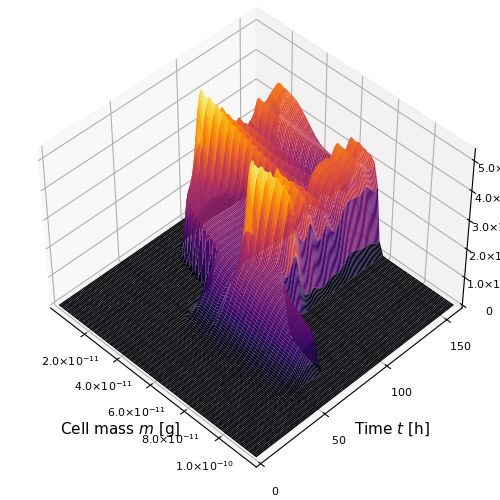

In [74]:
# switch to gr() backend for plotting 3d
# gr(html_output_format=:png)
pyplot(html_output_format=:png)

# summary plots
p_3dsurface_list = []
for (i,N_m_test) in enumerate(N_m_list)
    
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    
    p = plot(
        mc,
        res[i].t[begin:3:end],
        parsed_N_mt_list[i][begin:3:end,:],
        st=:surface,
        camera=(45,45),
        xlabel = L"Cell mass $m$ [g]",
        ylabel = L"Time $t$ [h]",
        zlabel = L"$N(m,t)$",
        colorbar = false
    )
    
    push!(p_3dsurface_list,p)
end
plot(
    p_3dsurface_list...,
    layout=(length(N_m_list),1),
    size = (500,500)
)

GIF creation ran for: 172.5968767


┌ Info: Saved animation to 
│   fn = /home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m50.gif
└ @ Plots /home/kkganko/.julia/packages/Plots/lW9ll/src/animation.jl:137


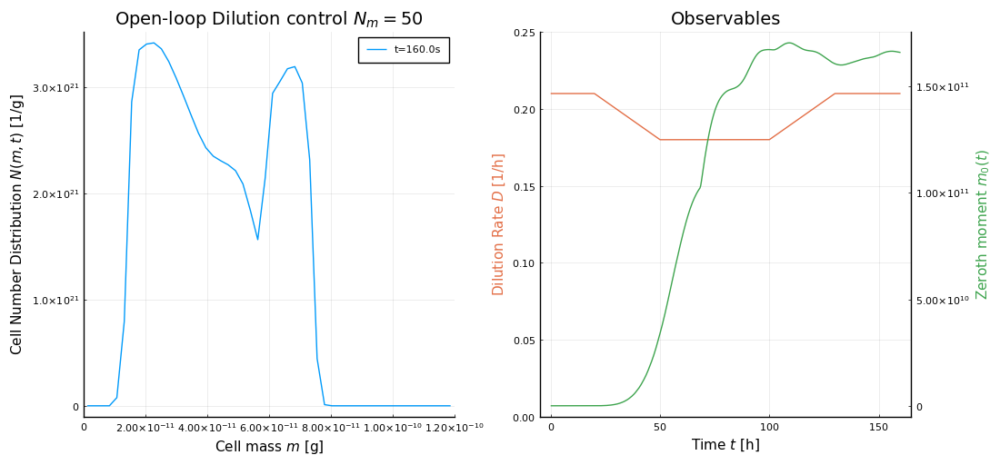

In [71]:
# animate the solutions at each N_m
time_to_completion = @elapsed begin
    gifs_list = []
    for (j,N_m_test) in enumerate(N_m_list)

        # initialize animation
        anim_variable_Nm_PBM = Animation()
        m_edges = collect(range(0.0,m_max,N_m_test+1))
        centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
        times = res[j].t
        results = parsed_N_mt_list[j]

        # go through each time point of N(m,t) and create frame for gif
        for i in 1:length(times)
            # one plot for showing changes in cell number distribution
            p1 = plot(
                centers,
                results[i,:],
                label="t=$(times[i])s",
                xlim = (0.0,m_max),
                title = L"Open-loop Dilution control $N_m = %$(N_m_test)$",
                xlabel = L"Cell mass $m$ [g]",
                ylabel = L"Cell Number Distribution $N(m,t)$ [1/g]"
            )
            # second plot for showing changes in dilution rate (open-loop controlled)
            p2 = plot(
                times[1:i],
                D_control.(times[1:i]),
                ylim = (0.0,0.25),
                xlabel = L"Time $t$ [h]",
                ylabel = L"Dilution Rate $D$ [1/h]",
                y_guidefontcolor = theme_palette(:auto)[2],
                color = 2,
                label = "",
                title = "Observables"
            )
            
            twin_p = twinx(p2)
            plot!(
                twin_p,
                times[1:i],
                m0_lists[j][1:i],
                ylabel = L"Zeroth moment $m_0(t)$",
                label = "",
                y_guidefontcolor = theme_palette(:auto)[3],
                color = 3,
                rightmargin = 30Plots.mm
            )
            
            full_p = plot(
                p1,
                p2,
                layout = (1,2),
                size = (1000,500)
            )
            frame(anim_variable_Nm_PBM)
        end

        # save to files
        anim_FDcomp_fp = "open-loop-control-N_m$(N_m_test).gif" # cannot have special characters in this file name!!! things like : will break it
        anim_FDcomp_savepath = joinpath(pwd(), anim_FDcomp_fp)
        gif_comp = gif(anim_variable_Nm_PBM, anim_FDcomp_savepath, fps = 10);
        push!(gifs_list,gif_comp)
    end
end
println("GIF creation ran for: $(time_to_completion)")

Plots.AnimatedGif("/home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m50.gif")
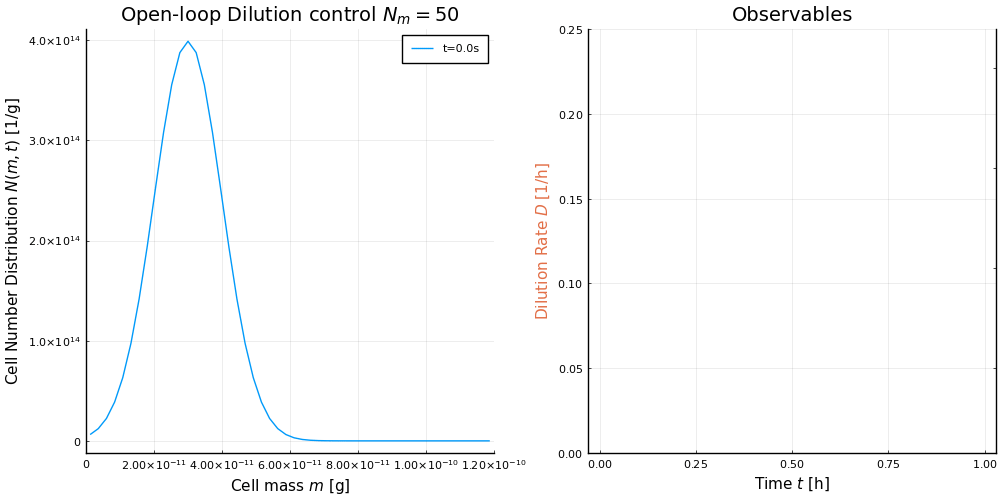

In [72]:
gifs_list[1]

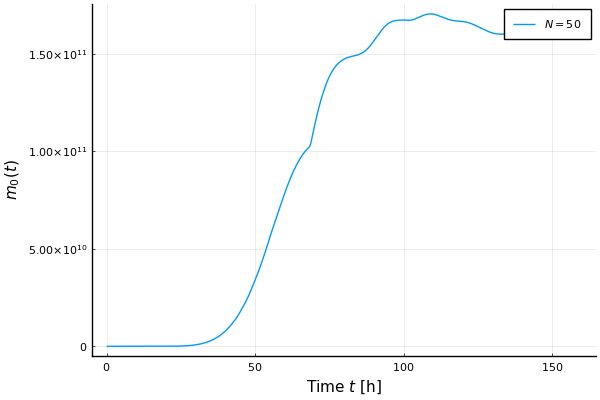

In [73]:
p = plot(
    xlabel = L"Time $t$ [h]",
    ylabel = L"$m_0(t)$"
)
for (i,N_m_test) in enumerate(N_m_list)
    plot!(
        p,
        res[i].t,
        m0_lists[i],
        label = L"$N=%$(N_m_test)$"
    )
end

p

# Shocking, looks like model output depends on timestep size... Show that profiles differ when $\Delta t$ is semi-constrained using `saveat` command and variable $N_t$

# Turns out issue was caused by SavingCallback not saving at specified `saveat` times... Instead it was saving the first $N_t$ points from the simulation, which meant that of the 3663 timesteps taken by solver for each simulation, the actual results saved were the first `[1,N_t]` of those

# Function description states to explicitly pass the `saveat` arg in the `solve` function to the `SavingCallback()`

In [430]:
# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 160.0                    # fig 4 final time [h]
N_t = 500                     # number of points to save at
tspan = (t0,tf)
u_0 = [
    0.6,                      # fig 4 initial substrate concentration [g/L]
    0.6                       # fig 4 initial filtered substrate concentration [g/L]
]

# track what times the ODE solver steps to
TSTEPS = []

# set-up problem and callbacks
function affect_and_control!(integrator)
    push!(TSTEPS,integrator.t)
    # modify dilution rate per explicit control trajectory (open-loop control)
    integrator.p[9] = D_control(integrator.t)
    N_mt_res, m0_res = py"step_yeast_PBM_v1"(
        integrator.u[2],       # S′
        integrator.p[1:end-2], # p_PBE
        integrator.p[end-1],   # N_mt from previous timestamp
        integrator.dt          # dt for stepping PBM
    )
    integrator.p[end-1] = N_mt_res
    integrator.p[end] = m0_res
end
# >= 100 mesh nodes stops working in simulations, getting the following numerical instability:
# ┌ Warning: Instability detected. Aborting
# └ @ SciMLBase /home/kkganko/.julia/packages/SciMLBase/qp2gL/src/integrator_interface.jl:606

N_m_list = [50] # [50,100,200]
N_t_list = [200,400,800]
res = []
saved_val_res = []
timings = []

for (i,N_m_test) in enumerate(N_m_list)
    for (j,N_t_test) in enumerate(N_t_list)
        # update param vals for correct mesh
        p_test[19] = N_m_test
        m_edges = collect(range(0.0,m_max,N_m_test+1))
        mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
        p_test[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
        p_test[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), p_test[20])

        condition(u,t,integrator) = true # callback at every time point
        cb_stepPBM_changeD = DiscreteCallback(condition,affect_and_control!;save_positions=(false,false))
        # saving callback info here: https://docs.sciml.ai/DiffEqCallbacks/stable/output_saving/#DiffEqCallbacks.SavingCallback
        saved_values = SavedValues(Float64, Tuple{Float64,Vector{Float64},Float64})
        cb_savingPBM = SavingCallback(
            (u,t,integrator)->(t,integrator.p[end-1],integrator.p[end]),
            saved_values
        )
        cbs = CallbackSet(cb_stepPBM_changeD,cb_savingPBM)

        # pose the problem
        prob_openloop = ODEProblem(
            substrateODEs_v1!,
            u_0,
            tspan,
            p_test,
            callback=cbs,
            tstops = [20.0,50.0,100.0,130.0],
            saveat = collect(range(tspan[1],tspan[2],N_t_test))
        )

        # solve the problem
        res_time = @elapsed begin
            sol_openloop = solve(
                prob_openloop, 
                Rodas5(autodiff = false),
                reltol = 1e-8,
                abstol = 1e-8
            )
        end

        push!(res,sol_openloop)
        push!(saved_val_res,saved_values)
        push!(timings, res_time)
        println("N_m=$(N_m_test) and N_t=$(N_t_test) done.")
    end
end

N_m=50 and N_t=200 done.


LoadError: InterruptException:

# Verifying that regardless of $N_t$ size, timesteps satisfying stability constraints are the same (yes, they are)

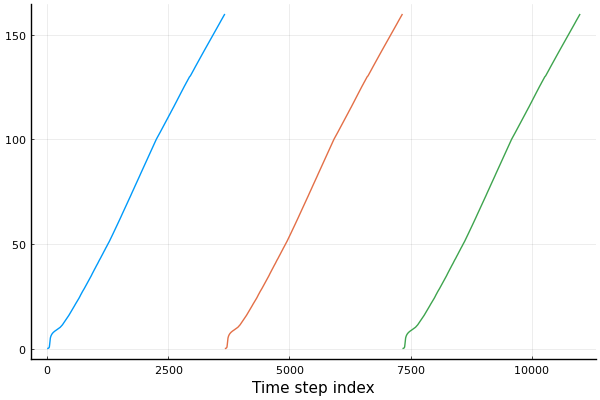

In [162]:
# find ending index for different simulations
end_ind = findall(t->t==tf,TSTEPS)

plot(
    1:end_ind[1],
    TSTEPS[1:end_ind[1]],
    label = "",
    xlabel = "Time step index"
)
plot!(
    end_ind[1]+1:end_ind[2],
    TSTEPS[end_ind[1]+1:end_ind[2]],
    label = "",
    xlabel = "Time step index"
)
plot!(
    end_ind[2]+1:end_ind[3],
    TSTEPS[end_ind[2]+1:end_ind[3]],
    label = "",
    xlabel = "Time step index"
)

In [170]:
# parse saved_values for cell mass distributions + zeroth order moment
parsed_N_mt_list = []
m0_lists = []
saved_val_times_list = []
for (i,N_m_test) in enumerate(N_m_list)
    for (k,N_t_test) in enumerate(N_t_list)
        N_mt_list_controlled = zeros(N_t_test,N_m_test)
        m0_list_controlled = []
        saved_val_times = []
        for j in 1:N_t_test
            push!(saved_val_times,saved_val_res[k].saveval[j][1])
            push!(m0_list_controlled,saved_val_res[k].saveval[j][3])
            N_mt_list_controlled[j,:] .= saved_val_res[k].saveval[j][2]
        end
        push!(parsed_N_mt_list,N_mt_list_controlled)
        push!(m0_lists,m0_list_controlled)
        push!(saved_val_times_list,saved_val_times)
    end
end

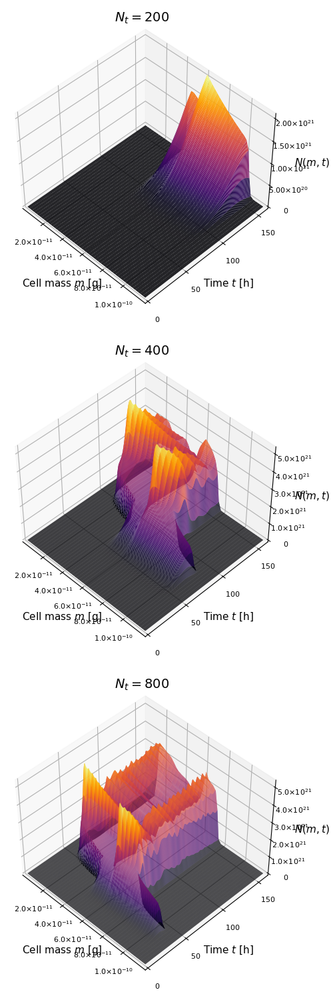

In [165]:
# switch to gr() backend for plotting 3d
# gr(html_output_format=:png)
pyplot(html_output_format=:png)

# summary plots
p_3dsurface_list = []
for (i,N_m_test) in enumerate(N_m_list)
    for (k,N_t_test) in enumerate(N_t_list)
        m_edges = collect(range(0.0,m_max,N_m_test+1))
        mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]

        p = plot(
            mc,
            res[k].t,
            parsed_N_mt_list[k],
            st=:surface,
            camera=(45,45),
            xlabel = L"Cell mass $m$ [g]",
            ylabel = L"Time $t$ [h]",
            zlabel = L"$N(m,t)$",
            colorbar = false,
            title = L"$N_t=%$(N_t_test)$"
        )

        push!(p_3dsurface_list,p)
    end
end
plot(
    p_3dsurface_list...,
    layout=(length(N_t_list),1),
    size = (500,1500),
    rightmargin = 20Plots.mm
)

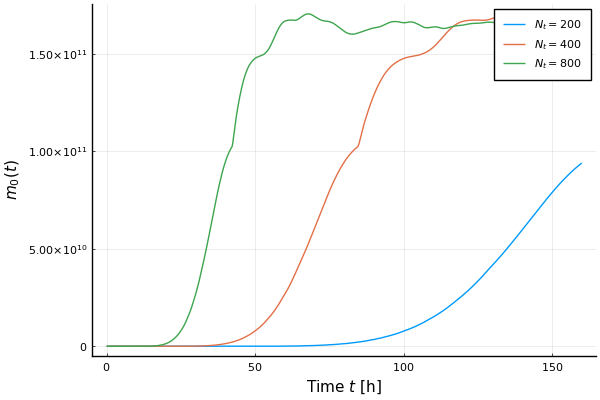

In [166]:
p = plot(
    xlabel = L"Time $t$ [h]",
    ylabel = L"$m_0(t)$"
)
for (i,N_t_test) in enumerate(N_t_list)
    plot!(
        p,
        res[i].t,
        m0_lists[i],
        label = L"$N_t=%$(N_t_test)$"
    )
end

p

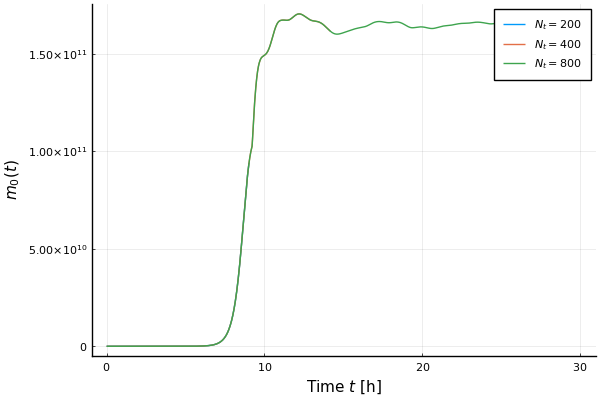

In [176]:
p = plot(
    xlabel = L"Time $t$ [h]",
    ylabel = L"$m_0(t)$"
)
for (i,N_t_test) in enumerate(N_t_list)
    plot!(
        p,
        saved_val_times_list[i],
        m0_lists[i],
        label = L"$N_t=%$(N_t_test)$"
    )
end

p

In [178]:
? SavingCallback

search: SavingCallback



```julia
SavingCallback(save_func, saved_values::SavedValues;
               saveat=Vector{eltype(saved_values.t)}(),
               save_everystep=isempty(saveat),
               save_start = true,
               tdir=1)
```

The saving callback lets you define a function `save_func(u, t, integrator)` which returns quantities of interest that shall be saved.

## Arguments

  * `save_func(u, t, integrator)` returns the quantities which shall be saved. Note that this should allocate the output (not as a view to `u`).
  * `saved_values::SavedValues` is the types that `save_func` will return, i.e. `save_func(t, u, integrator)::savevalType`. It's specified via `SavedValues(typeof(t),savevalType)`, i.e. give the type for time and the type that `save_func` will output (or higher compatible type).

## Keyword Arguments

  * `saveat` mimics `saveat` in `solve` from `solve`.
  * `save_everystep` mimics `save_everystep` from `solve`.
  * `save_start` mimics `save_start` from `solve`.
  * `tdir` should be `sign(tspan[end]-tspan[1])`. It defaults to `1` and should be adapted if `tspan[1] > tspan[end]`.

The outputted values are saved into `saved_values`. Time points are found via `saved_values.t` and the values are `saved_values.saveval`.


In [431]:
# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 160.0                    # fig 4 final time [h]
N_t = 500                     # number of points to save at
tspan = (t0,tf)
u_0 = [
    0.6,                      # fig 4 initial substrate concentration [g/L]
    0.6                       # fig 4 initial filtered substrate concentration [g/L]
]

# track what times the ODE solver steps to
TSTEPS = []

# set-up problem and callbacks
function affect_and_control!(integrator)
    push!(TSTEPS,integrator.t)
    # modify dilution rate per explicit control trajectory (open-loop control)
    integrator.p[9] = D_control(integrator.t)
    N_mt_res, m0_res = py"step_yeast_PBM_v1"(
        integrator.u[2],       # S′
        integrator.p[1:end-2], # p_PBE
        integrator.p[end-1],   # N_mt from previous timestamp
        integrator.dt          # dt for stepping PBM
    )
    integrator.p[end-1] = N_mt_res
    integrator.p[end] = m0_res
end
# >= 100 mesh nodes stops working in simulations, getting the following numerical instability:
# ┌ Warning: Instability detected. Aborting
# └ @ SciMLBase /home/kkganko/.julia/packages/SciMLBase/qp2gL/src/integrator_interface.jl:606

N_m_list = [50] # [50,100,200]
N_t_list = [200,400,800]
res = []
saved_val_res = []
timings = []

for (i,N_m_test) in enumerate(N_m_list)
    for (j,N_t_test) in enumerate(N_t_list)
        # update param vals for correct mesh
        p_test[19] = N_m_test
        m_edges = collect(range(0.0,m_max,N_m_test+1))
        mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
        p_test[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
        p_test[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), p_test[20])

        condition(u,t,integrator) = true # callback at every time point
        cb_stepPBM_changeD = DiscreteCallback(condition,affect_and_control!;save_positions=(false,false))
        # saving callback info here: https://docs.sciml.ai/DiffEqCallbacks/stable/output_saving/#DiffEqCallbacks.SavingCallback
        saved_values = SavedValues(Float64, Tuple{Float64,Vector{Float64},Float64})
        cb_savingPBM = SavingCallback(
            (u,t,integrator)->(t,integrator.p[end-1],integrator.p[end]),
            saved_values,
            saveat = collect(range(tspan[1],tspan[2],N_t_test))
        )
        cbs = CallbackSet(cb_stepPBM_changeD,cb_savingPBM)

        # pose the problem
        prob_openloop = ODEProblem(
            substrateODEs_v1!,
            u_0,
            tspan,
            p_test,
            callback=cbs,
            tstops = [20.0,50.0,100.0,130.0],
            saveat = collect(range(tspan[1],tspan[2],N_t_test))
        )

        # solve the problem
        res_time = @elapsed begin
            sol_openloop = solve(
                prob_openloop, 
                Rodas5(autodiff = false),
                reltol = 1e-8,
                abstol = 1e-8
            )
        end

        push!(res,sol_openloop)
        push!(saved_val_res,saved_values)
        push!(timings, res_time)
        println("N_m=$(N_m_test) and N_t=$(N_t_test) done.")
    end
end

N_m=50 and N_t=200 done.
N_m=50 and N_t=400 done.
N_m=50 and N_t=800 done.


In [434]:
# parse saved_values for cell mass distributions + zeroth order moment
parsed_N_mt_list = []
m0_lists = []
saved_val_times_list = []
for (i,N_m_test) in enumerate(N_m_list)
    for (k,N_t_test) in enumerate(N_t_list)
        N_mt_list_controlled = zeros(N_t_test,N_m_test)
        m0_list_controlled = []
        saved_val_times = []
        for j in 1:N_t_test
            push!(saved_val_times,saved_val_res[k].saveval[j][1])
            push!(m0_list_controlled,saved_val_res[k].saveval[j][3])
            N_mt_list_controlled[j,:] .= saved_val_res[k].saveval[j][2]
        end
        push!(parsed_N_mt_list,N_mt_list_controlled)
        push!(m0_lists,m0_list_controlled)
        push!(saved_val_times_list,saved_val_times)
    end
end

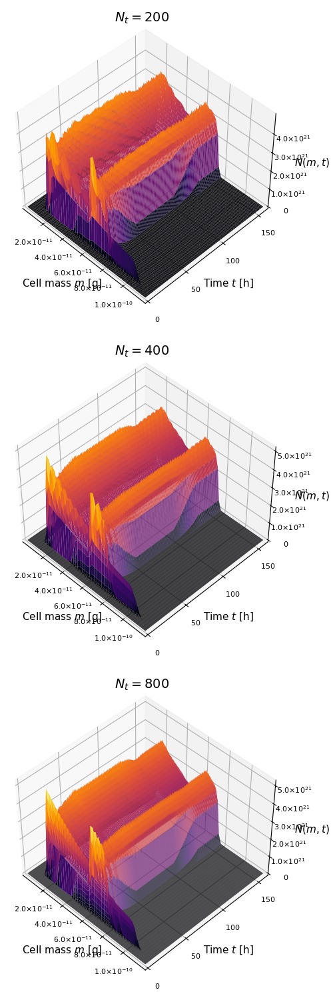

In [433]:
# switch to gr() backend for plotting 3d
# gr(html_output_format=:png)
pyplot(html_output_format=:png)

# summary plots
p_3dsurface_list = []
for (i,N_m_test) in enumerate(N_m_list)
    for (k,N_t_test) in enumerate(N_t_list)
        m_edges = collect(range(0.0,m_max,N_m_test+1))
        mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]

        p = plot(
            mc,
            res[k].t,
            parsed_N_mt_list[k],
            st=:surface,
            camera=(45,45),
            xlabel = L"Cell mass $m$ [g]",
            ylabel = L"Time $t$ [h]",
            zlabel = L"$N(m,t)$",
            colorbar = false,
            title = L"$N_t=%$(N_t_test)$"
        )

        push!(p_3dsurface_list,p)
    end
end
plot(
    p_3dsurface_list...,
    layout=(length(N_t_list),1),
    size = (500,1500),
    rightmargin = 20Plots.mm
)

GIF creation ran for: 113.8400193


┌ Info: Saved animation to 
│   fn = /home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m50.gif
└ @ Plots /home/kkganko/.julia/packages/Plots/lW9ll/src/animation.jl:137


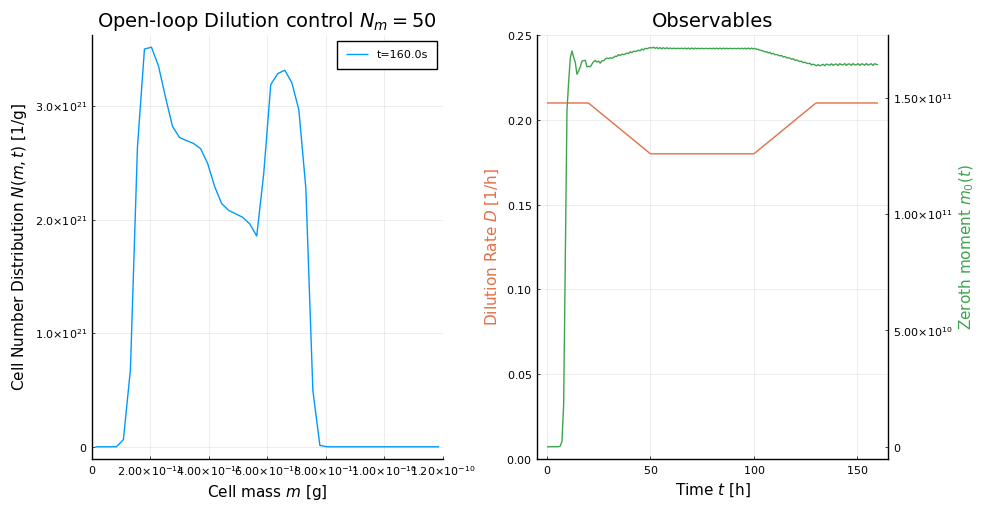

In [440]:
# animate the solutions at each N_m
time_to_completion = @elapsed begin
    gifs_list = []
    for (j,N_m_test) in enumerate(N_m_list)

        # initialize animation
        anim_variable_Nm_PBM = Animation()
        m_edges = collect(range(0.0,m_max,N_m_test+1))
        centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
        times = saved_val_times_list[j] #res[j].t
        results = parsed_N_mt_list[j]

        # go through each time point of N(m,t) and create frame for gif
        for i in 1:length(times)
            # one plot for showing changes in cell number distribution
            p1 = plot(
                centers,
                results[i,:],
                label="t=$(times[i])s",
                xlim = (0.0,m_max),
                title = L"Open-loop Dilution control $N_m = %$(N_m_test)$",
                xlabel = L"Cell mass $m$ [g]",
                ylabel = L"Cell Number Distribution $N(m,t)$ [1/g]"
            )
            # second plot for showing changes in dilution rate (open-loop controlled)
            p2 = plot(
                times[1:i],
                D_control.(times[1:i]),
                ylim = (0.0,0.25),
                xlabel = L"Time $t$ [h]",
                ylabel = L"Dilution Rate $D$ [1/h]",
                y_guidefontcolor = theme_palette(:auto)[2],
                color = 2,
                label = "",
                title = "Observables",
                rightmargin = 30Plots.mm
            )
            
            twin_p = twinx(p2)
            plot!(
                twin_p,
                times[1:i],
                m0_lists[j][1:i],
                ylabel = L"Zeroth moment $m_0(t)$",
                label = "",
                y_guidefontcolor = theme_palette(:auto)[3],
                color = 3
            )
            
            full_p = plot(
                p1,
                p2,
                layout = (1,2),
                size = (1000,500)
            )
            frame(anim_variable_Nm_PBM)
        end

        # save to files
        anim_FDcomp_fp = "open-loop-control-N_m$(N_m_test).gif" # cannot have special characters in this file name!!! things like : will break it
        anim_FDcomp_savepath = joinpath(pwd(), anim_FDcomp_fp)
        gif_comp = gif(anim_variable_Nm_PBM, anim_FDcomp_savepath, fps = 5);
        push!(gifs_list,gif_comp)
    end
end
println("GIF creation ran for: $(time_to_completion)")

Plots.AnimatedGif("/home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m50.gif")
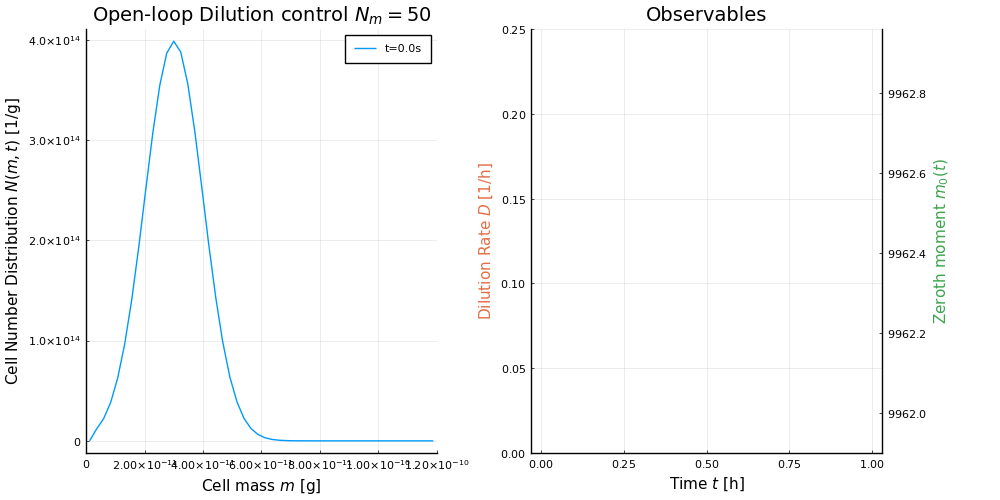

In [441]:
gifs_list[1]

# Modify to MOL system

Method of Lines (MOL) discretization requires applying some discretization to the derivatives of the (N-1) independent variables of the PDE. For the first-order hyperbolic IPDE, 

$$
\begin{gathered}
\frac{\partial N(m,t)}{\partial t} + \frac{\partial [ k(S^\prime) N(m,t) ]}{\partial m} = \\ 2\int_0^{m_{\textrm{max}}}\Gamma(m^\prime,S^\prime)p(m,m^\prime,m_t^*(S^\prime))N(m^\prime,t)dm^\prime - [D+\Gamma(m,S^\prime)]N(m,t) = \Psi(t,m,N),\\
\textrm{IC: }N(m,0) = N_0(m) = \frac{N_{00}}{\sigma_0\sqrt{2\pi}} \exp\left(\frac{-(m-\mu_0)^2}{2\sigma_0^2}\right), \\
\textrm{Regularity condition/inflow BC: } G(0,t)N(0,t) = \lim_{m\to m_{\textrm{max}}} G(m,t)N(m,t) = 0,
\end{gathered}
$$

discretization in the cell mass $m$ with a first-order upwind scheme would look like:

$$
\begin{gathered}
\Delta m_j = m_j - m_{j-1}~\forall j=2,\ldots,N,\\
N(m_j,t)=N_j(t),\\
\frac{\partial [ k(S^\prime) N(m,t) ]}{\partial m} = \frac{k(S^\prime) \left(N_j(t) - N_{j-1}(t)\right)}{\Delta m_j} \\
\frac{\textrm{d}N_j(t)}{\textrm{d}t} = -\frac{k(S^\prime) \left(N_j(t) - N_{j-1}(t)\right)}{\Delta m_j} + 2\int_0^{m_{\textrm{max}}}\Gamma(m^\prime,S^\prime)p(m_j,m^\prime,m_t^*(S^\prime))N(m^\prime,t)dm^\prime - [D+\Gamma(m_j,S^\prime)]N_j(t), \\
N_1(t) = 0, \\
F(m_j,S^\prime) = 2\int_0^{m_{\textrm{max}}}\Gamma(m^\prime,S^\prime)p(m_j,m^\prime,m_t^*(S^\prime))N(m^\prime,t)dm^\prime.
\end{gathered}
$$

The remaining ODEs and zeroth moment equation reduce to:

$$
\begin{gathered}
m_0(t)=\int_0^{m_\textrm{max}}N(m,t)\textrm{d}m \\
\frac{\textrm{d}S}{\textrm{d}t} = D(S_f-S)-\int_0^{m_\textrm{max}}\frac{k(S^\prime)}{Y} N(m,t)\textrm{d}m = D(S_f-S)-\frac{k(S^\prime)}{Y}m_0(t)
\end{gathered}
$$

$$
\begin{gathered}
\frac{\textrm{d}S^\prime}{\textrm{d}t} = \alpha (S-S^\prime) \\
S^\prime(t=0)=S_0^\prime=S(t=0) \\
k(S') = \frac{\mu_m S^\prime}{K_m + S^\prime}
\end{gathered}
$$

In [327]:
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, μ::AbstractFloat, σ::AbstractFloat) = @. 1/σ/sqrt(2*pi) * exp( -(x - μ)^2 / 2 / σ^2)
k_m(S_prime::Union{AbstractFloat,AbstractArray}, μ_m::AbstractFloat, K_m::AbstractFloat) = @. μ_m*S_prime/(K_m+S_prime)

# define for both transition mass and critical mass
function m_td(
        S_prime::AbstractFloat,
        m_td0::AbstractFloat,
        K_td::AbstractFloat,
        S_l::AbstractFloat,
        S_h::AbstractFloat
    )
    if S_prime < S_l
        return m_td0 + K_td*(S_l - S_h)
    elseif (S_prime > S_l) && (S_prime < S_h)
        return m_td0 + K_td*(S_prime - S_h)
    else
        return m_td0
    end
end

function Γ(
        m::AbstractFloat,
        γ::AbstractFloat,
        ϵ::AbstractFloat,
        m_t::AbstractFloat,
        m_d::AbstractFloat,
        m_a::AbstractFloat
    )
    
    if m < m_t+m_a
        return 0.0
    elseif (m > m_t+m_a) && (m < m_d)
        return γ*exp(-ϵ*(m-m_d)^2)
    else
        return γ
    end
    
end
    
function p_mm(
        m::AbstractFloat,
        m_prime::AbstractFloat,
        m_t::AbstractFloat,
        m_a::AbstractFloat,
        A::AbstractFloat,
        β::AbstractFloat
    )

    if m > m_prime
        return 0.0
    elseif m_prime < (m_t + m_a)
        return 0.0
    else
        # full expression produces overflow errors, maybe do post-processing
        # A*(np.exp(β*(m-m_t)**2)+np.exp(β*(m-m_prime+m_t)**2))
        # turns out Hensen paper had typos!! should have negative sign in front of β's
        return A*(exp(-β*(m-m_t)^2) + exp(-β*(m-m_prime+m_t)^2))
    end
end

function kernel_mat(
        m_list::AbstractArray,
        N_m::Int,
        m_t::AbstractFloat,
        m_a::AbstractFloat,
        A::AbstractFloat,
        β::AbstractFloat,
        Γ::AbstractArray
    )

    p_mm_mat = zeros((N_m,N_m))
    for i in range(1,N_m)
        for j in range(1,N_m)
            p_mm_mat[j,i] = p_mm(m_list[i], m_list[j], m_t, m_a, A, β)
        end
    end
    
    # np.multiply is an element-wise multiplication of the two input arrays, i.e., explicit broadcasting
    kernel_m = Γ .* p_mm_mat # mother cell info on columns
    return kernel_m
end

# helper functions
function cumtrapz(X::AbstractVector, Y::AbstractVector)
    # Check matching vector length
    @assert length(X) == length(Y)
    
    # Initialize Output
    out = 0.0

    # Iterate over arrays
    @inbounds for i in 2:length(X)
        out += 0.5*(X[i] - X[i-1])*(Y[i] + Y[i-1])
    end
    # Return output
    return out
end

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 300                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
N_IC[1] = 0.0
m0 = cumtrapz(mc,N_IC)
S_prime_test = S_f/2.0
m_t_test = m_td(S_prime_test,m_t0,K_t,S_l,S_h)
m_d_test = m_td(S_prime_test,m_d0,K_d,S_l,S_h)
Γ_test = Γ.(mc,γ,ϵ,m_t_test,m_d_test,m_a)
p_mm_test = zeros((N_m,N_m))
for i in range(1,N_m)
    for j in range(1,N_m) 
        p_mm_test[j,i] = p_mm(mc[i], mc[j], m_t_test, m_a, A, β)
    end
end
kernel_test = kernel_mat(mc,N_m,m_t_test,m_a,A,β,Γ_test)
k_test = k_m(S_prime_test, μ_m, K_m)

1.6666666666666669e-10

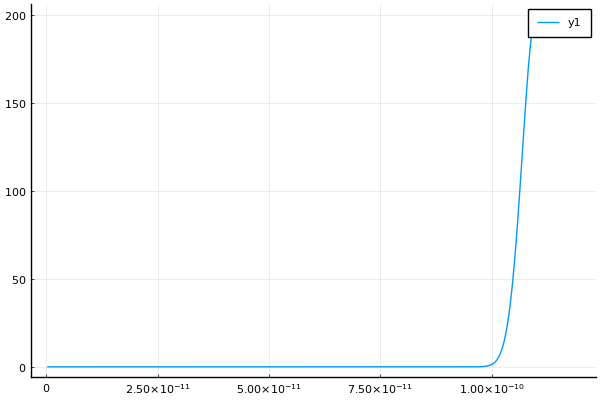

In [215]:
plot(
    mc,
    N_IC
)
plot(
    mc,
    Γ_res
)

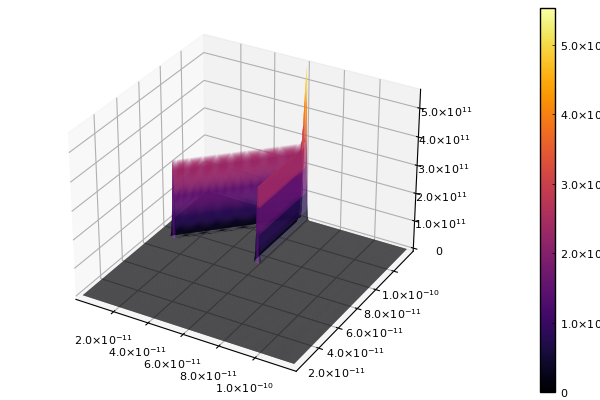

In [216]:
plot(
    mc,
    mc,
    p_mm_test,
    st=:surface
)

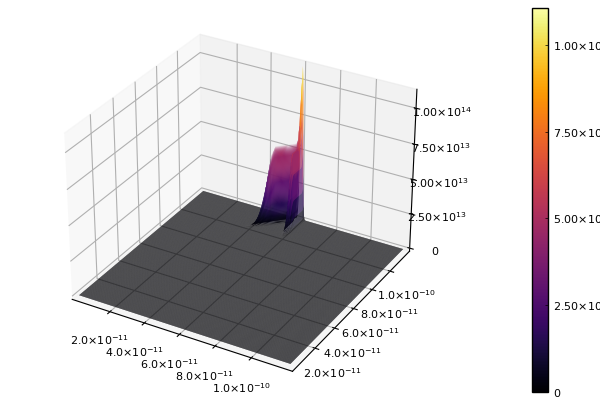

In [223]:
plot(
    mc,
    mc,
    kernel_test,
    st=:surface
)

In [271]:
function yeast_PBM_MOL!(
        du::Vector{Float64},
        u::Vector{Float64},
        p_PBE::Vector{Float64},
        t::Float64
    )

    # unpack only the necessary params for ODE simulations
    γ = p_PBE[1]                   # 1/hr, maximum fission rate, when cell m ≥ m_d
    A = p_PBE[2]                   # 1/g, partition function exponential prefactors (i.e., p(m,m'))
    S_l = p_PBE[3]                 # g/L, low substrate limit
    K_t = p_PBE[4]                 # g/g/L, proportionality constant for change in transition mass with substrate levels
    m_t0 = p_PBE[5]                # g, initial transition mass (at low substrate levels)
    m_max = p_PBE[6]               # g, maximal cell mass allowed
    Y = p_PBE[7]                   # g/g, yield coefficient for cell mass to mols substrate
    K_m = p_PBE[8]                 # g/L, Monod constant for single cell growth rate
    D = p_PBE[9]                   # 1/h, dilution rate in continuous bioreactor operation
    ϵ = p_PBE[10]                   # g^{-2}, inverse variance for fission rate when cells are in fissioning state
    β = p_PBE[11]                  # g^{-2}, another inverse variance for partition function
    S_h = p_PBE[12]                # g/L, high substrate limit
    K_d = p_PBE[13]                # g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
    m_d0 = p_PBE[14]               # g, initial critical fissioning mass (at low substrate levels)
    m_a = p_PBE[15]                # g, additional mass that mother cell must gain to start fissioning
    μ_m = p_PBE[16]                # g/h, single cell growth rate in limit of high substrate levels
    α = p_PBE[17]                  # 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
    S_f = p_PBE[18]                # g/L, feed concentration of substrate to continuous bioreactor
    N_m = Int(p_PBE[19])           # number of grid points in mass domain
    
    # compute other vars
    m_edges = collect(range(0.0,m_max,(N_m+1)))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_res = m_td(u[(N_m+1)],m_t0,K_t,S_l,S_h)
    m_d_res = m_td(u[(N_m+1)],m_d0,K_d,S_l,S_h)
    k_res = k_m(u[(N_m+1)],μ_m,K_m)
    Γ_test = Γ.(mc,γ,ϵ,m_t_res,m_d_res,m_a)
    kernel_test = kernel_mat(mc,N_m,m_t_res,m_a,A,β,Γ_test)
    
    m0 = cumtrapz(mc,u[1:N_m])
    du[1] = 0.0
    # for kernel, compute over all N_j nodes
    for j in 2:N_m
        du[j] = -k_res * (u[j] - u[j-1]) / (mc[j] - mc[j-1]) + 
                    2.0 * cumtrapz(mc, kernel_test[:,j] .* u[1:N_m]) .-
                    (D + Γ_test[j]) .* u[j]
    end
    du[(N_m+1)] = D*(S_f-u[(N_m+1)]) - k_res/Y*m0
    du[(N_m+2)] = α*(u[(N_m+2)] - u[(N_m+1)])
    du[(N_m+3)] = u[(N_m+3)] - m0
end

yeast_PBM_MOL! (generic function with 2 methods)

In [406]:
# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 50                      # 19) -, number of grid points in mass domain

# IC
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_pdf(mc,μ_0,σ_0)
N_IC[1] = 0.0
m0 = cumtrapz(mc,N_IC)
S0 = S_f
S_prime0 = S_f
u_0 = vcat(N_IC,S0,S_prime0,m0)

# define mass matrix for DAE solve (looks like index-1 system)
# last state is algebraic
M = Float64.(Matrix(I(N_m+3)))
M[end,end] = 0.0

# params vector
p_test_MOL = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 1.0                    # fig 4 final time [h]
N_t = 500                     # number of points to save at
tspan = (t0,tf)

# define callbacks (none necessary)
# pose the problem
prob_openloop = ODEProblem(
    ODEFunction(yeast_PBM_MOL!, mass_matrix = M),
    u_0,
    tspan,
    p_test_MOL,
#     tstops = [20.0,50.0,100.0,130.0],
#     saveat = collect(range(tspan[1],tspan[2],N_t))
)

# solve the problem
# also giving complaints when autodiff is on...
# also giving complaints with instability detected when Rodas5 used
# go for an implicit low order scheme
res_time = @elapsed begin
    sol_openloop = solve(
        prob_openloop, 
        Rodas5(autodiff=false),
        reltol = 1e-8,
        abstol = 1e-8
    )
end
println(res_time) # for 1 seconds of simulation, Rodas5(autodiff=false) for N_m=50 is ~7.50s!
# expect N_m=50 for 160.0 seconds, 20 minutes!

7.8092958


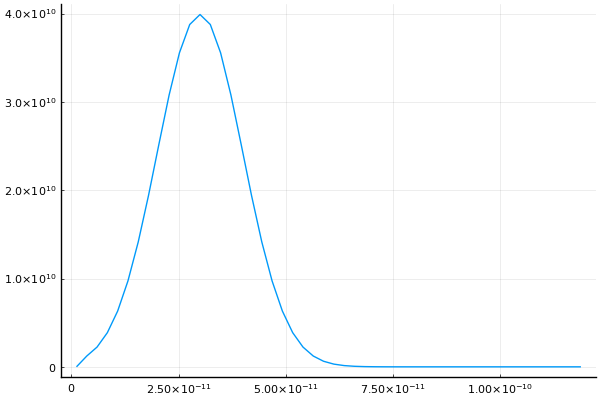

In [407]:
plot(mc,sol_openloop[1:N_m,1],label = "")

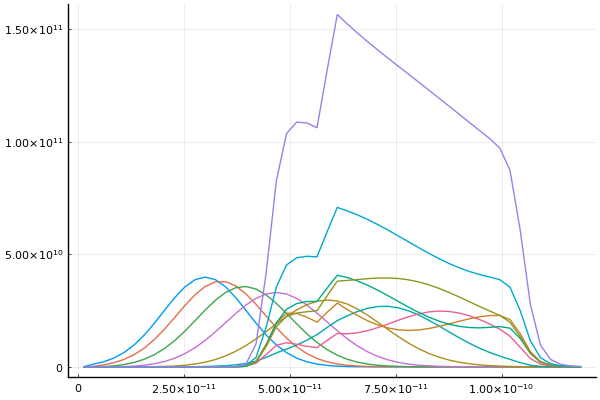

In [408]:
p = plot()
for i in 1:50:length(sol_openloop.t)
    plot!(p,mc,sol_openloop[1:N_m,i],label = "")
end
p

# Naive mass matrix approach / semi-implicit DAE approach is not working due to numerical instabilities. Two solutions are possible:

1. Rescale the problem to have more normal cell mass and smaller number distributions.
2. Run using DAEProblem and Sundials.jl `IDA` solver.
3. Reformulate so you solve the modified system with $\textrm{d}m_0/\textrm{d}t$ (then the system becomes an ODE).
4. Or... just don't use MOL at all. You can try using higher order integration.
5. Or... use the less violent parameter set values from earlier Hensen works.

In [409]:
# DAE formulation
function yeast_PBM_MOL_DAE!(
        out::Vector{Float64},
        du::Vector{Float64},
        u::Vector{Float64},
        p_PBE::Vector{Float64},
        t::Float64
    )
    
    if t>39.0
        println(t)
    end
    # unpack only the necessary params for ODE simulations
    γ = p_PBE[1]                   # 1/hr, maximum fission rate, when cell m ≥ m_d
    A = p_PBE[2]                   # 1/g, partition function exponential prefactors (i.e., p(m,m'))
    S_l = p_PBE[3]                 # g/L, low substrate limit
    K_t = p_PBE[4]                 # g/g/L, proportionality constant for change in transition mass with substrate levels
    m_t0 = p_PBE[5]                # g, initial transition mass (at low substrate levels)
    m_max = p_PBE[6]               # g, maximal cell mass allowed
    Y = p_PBE[7]                   # g/g, yield coefficient for cell mass to mols substrate
    K_m = p_PBE[8]                 # g/L, Monod constant for single cell growth rate
    D = p_PBE[9]                   # 1/h, dilution rate in continuous bioreactor operation
    ϵ = p_PBE[10]                   # g^{-2}, inverse variance for fission rate when cells are in fissioning state
    β = p_PBE[11]                  # g^{-2}, another inverse variance for partition function
    S_h = p_PBE[12]                # g/L, high substrate limit
    K_d = p_PBE[13]                # g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
    m_d0 = p_PBE[14]               # g, initial critical fissioning mass (at low substrate levels)
    m_a = p_PBE[15]                # g, additional mass that mother cell must gain to start fissioning
    μ_m = p_PBE[16]                # g/h, single cell growth rate in limit of high substrate levels
    α = p_PBE[17]                  # 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
    S_f = p_PBE[18]                # g/L, feed concentration of substrate to continuous bioreactor
    N_m = Int(p_PBE[19])           # number of grid points in mass domain
    
    # compute other vars
    m_edges = collect(range(0.0,m_max,(N_m+1)))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_res = m_td(u[(N_m+1)],m_t0,K_t,S_l,S_h)
    m_d_res = m_td(u[(N_m+1)],m_d0,K_d,S_l,S_h)
    k_res = k_m(u[(N_m+1)],μ_m,K_m)
    Γ_test = Γ.(mc,γ,ϵ,m_t_res,m_d_res,m_a)
    kernel_test = kernel_mat(mc,N_m,m_t_res,m_a,A,β,Γ_test)
    
    m0 = cumtrapz(mc,u[1:N_m])
    out[1] = du[1]
    # for kernel, compute over all N_j nodes
    for j in 2:N_m
        out[j] = du[j] - (-k_res * (u[j] - u[j-1]) / (mc[j] - mc[j-1]) + 
                    2.0 * cumtrapz(mc, kernel_test[:,j] .* u[1:N_m]) .-
                    (D + Γ_test[j]) .* u[j])
    end
    out[(N_m+1)] = du[(N_m+1)] - (D*(S_f-u[(N_m+1)]) - k_res/Y*m0)
    out[(N_m+2)] = du[(N_m+2)] - α*(u[(N_m+2)] - u[(N_m+1)])
    out[(N_m+3)] = u[(N_m+3)] - m0
end

yeast_PBM_MOL_DAE! (generic function with 1 method)

In [426]:
# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 100                      # 19) -, number of grid points in mass domain

# IC
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_pdf(mc,μ_0,σ_0)
N_IC[1] = 0.0
m0 = cumtrapz(mc,N_IC)
S0 = S_f
S_prime0 = S_f
u_0 = vcat(N_IC,S0,S_prime0,m0)

# params vector
p_test_MOL = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 37.0                    # fig 4 final time [h]
N_t = 500                     # number of points to save at
tspan = (t0,tf)

# define differential variables
differential_vars = [true for i in 1:N_m+3]
differential_vars[end] = false

# for large scale DAEs, should use Sundials.jl IDA
# https://docs.sciml.ai/DiffEqDocs/stable/solvers/dae_solve/
prob_openloop_DAE = DAEProblem(
    yeast_PBM_MOL_DAE!,
    zeros(length(u_0)),
    u_0,
    tspan,
    p_test_MOL,
    differential_vars = differential_vars
)

res_time = @elapsed begin
    sol_openloop_DAE = solve(
        prob_openloop_DAE, 
        Sundials.IDA(linear_solver=:Dense),
        reltol = 1e-8,
        abstol = 1e-8
    )
end
println(res_time) # 1.15s wall time for 1.0 second of simulation

LoadError: InterruptException:

In [423]:
sol_openloop_DAE.t

17892-element Vector{Float64}:
  0.0
  4.7953955243433905e-11
  9.590791048686781e-11
  1.9181582097373562e-10
  3.8363164194747124e-10
  7.672632838949425e-10
  1.534526567789885e-9
  3.06905313557977e-9
  6.13810627115954e-9
  1.227621254231908e-8
  2.455242508463816e-8
  4.910485016927632e-8
  9.820970033855264e-8
  ⋮
 35.9742852561046
 35.97673250980609
 35.97917976350758
 35.98162701720907
 35.98407427091056
 35.98652152461205
 35.98896877831354
 35.99141603201503
 35.99386328571652
 35.99631053941801
 35.9987577931195
 36.0

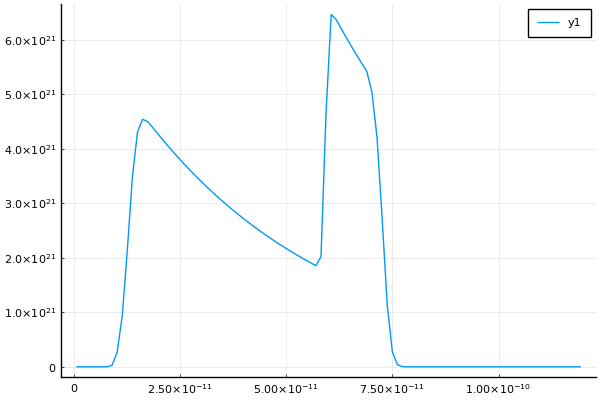

In [425]:
plot(mc,sol_openloop_DAE.u[end][1:N_m])

# Include zeroth moment explicitly into ODE system

One can simulate the system as an ODE:

$$
\begin{gathered}
\frac{\textrm{d}m_0}{\textrm{d}t} = -D m_0 + \int_0^{m_\textrm{max}}\Gamma(m,S^\prime)N(m,t)\textrm{d}m~,\\
\frac{\textrm{d}S}{\textrm{d}t} = D(S_f-S)-\frac{k(S^\prime)}{Y}m_0(t),\\\
\frac{\textrm{d}S^\prime}{\textrm{d}t} = \alpha (S-S^\prime) \\
S^\prime(t=0)=S_0^\prime=S(t=0) \\
k(S') = \frac{\mu_m S^\prime}{K_m + S^\prime}
\end{gathered}
$$

There are concerns that the resulting equations are not well-posed, as the zeroth moment ODE is just a reduction of the full cell PBM. The approach would be to output the fission-rate weighted integral kernel on each solve of the PBM.

In [51]:
# wrapper for PyClaw routine
py"""
# import relevant packages
import numpy as np
from scipy.stats import norm
from scipy.special import erf
from scipy.special import beta

from clawpack import pyclaw
from clawpack import riemann

# define helper functions
N_pdf_py = lambda x,mu,sigma : norm.pdf(x, loc = mu, scale = sigma)
midpt_trapz = lambda delx_list,y_c : np.dot(delx_list,y_c)
k_m = lambda S_prime, μ_m, K_m: (μ_m * S_prime)/(K_m + S_prime)

# define for both transition mass and critical mass
def m_td(S_prime,m_td0,K_td,S_l,S_h):
    if S_prime < S_l:
        return m_td0 + K_td*(S_l - S_h)
    elif (S_prime > S_l) and (S_prime < S_h):
        return m_td0 + K_td*(S_prime - S_h)
    else:
        return m_td0

# define fission rate function
@np.vectorize
def Γ(m,γ,ϵ,m_t,m_d,m_a):
    if m < m_t+m_a:
        return 0.0
    elif (m > m_t+m_a) and (m < m_d):
        return γ*np.exp(-ϵ*(m-m_d)**2)
    else:
        return γ

# partition function
def p_mm(m,m_prime,m_t,m_a,A,β):
    if m > m_prime:
        return 0.0
    elif m_prime < (m_t + m_a):
        return 0.0
    else:
        # full expression produces overflow errors, maybe do post-processing
        # A*(np.exp(β*(m-m_t)**2)+np.exp(β*(m-m_prime+m_t)**2))
        # turns out Hensen paper had typos!! should have negative sign in front of β's
        return A*(np.exp(-β*(m-m_t)**2)+np.exp(-β*(m-m_prime+m_t)**2))

def kernel_mat(m_list, N_m, m_t, m_a, A, β, Γ):

    p_mm_mat = np.zeros((N_m,N_m))

    for j in np.arange(0,N_m):
        for i in np.arange(0,N_m):
            p_mm_mat[j,i] = p_mm(m = m_list[i], m_prime = m_list[j], m_t=m_t, m_a=m_a, A=A, β=β)
    
    # np.multiply is an element-wise multiplication of the two input arrays, i.e., explicit broadcasting
    kernel_m = np.multiply(np.outer(Γ, np.ones(N_m)), p_mm_mat) # mother cell info on columns
    return kernel_m

# for generating the RHS of the solver, but also fed directly to solver
def dq_linhom_src(solver,state,dt):
    
    N_mt = state.q[0,:]
    Γ = state.aux[0,:] # Γ
    mc = state.grid.m.centers
    del_mc_list = np.multiply(np.ones(len(mc)), (mc[1]-mc[0]))

    # compute integral expression
    F = np.zeros(state.problem_data['N_m'])
    for i in range(1,state.problem_data['N_m']+1):
        F[i-1] = midpt_trapz(del_mc_list, np.multiply(state.aux[i,:], N_mt))

    # compute full RHS source term
    dq = np.empty(state.q.shape)
    D = state.problem_data['D']
    dq[0,:] = dt * (-(D + Γ) * N_mt + 2.0 * F)   
    return dq

def step_yeast_PBM_v2(S_prime, p_PBE, N_IC, dt):

    γ = p_PBE[0]                   # 1/hr, maximum fission rate, when cell m ≥ m_d
    A = p_PBE[1]                   # 1/g, partition function exponential prefactors (i.e., p(m,m'))
    S_l = p_PBE[2]                 # g/L, low substrate limit
    K_t = p_PBE[3]                 # g/g/L, proportionality constant for change in transition mass with substrate levels
    m_t0 = p_PBE[4]                # g, initial transition mass (at low substrate levels)
    m_max = p_PBE[5]               # g, maximal cell mass allowed
    Y = p_PBE[6]                   # g/g, yield coefficient for cell mass to mols substrate
    K_m = p_PBE[7]                 # g/L, Monod constant for single cell growth rate
    D = p_PBE[8]                   # 1/h, dilution rate in continuous bioreactor operation
    ϵ = p_PBE[9]                   # g^{-2}, inverse variance for fission rate when cells are in fissioning state
    β = p_PBE[10]                  # g^{-2}, another inverse variance for partition function
    S_h = p_PBE[11]                # g/L, high substrate limit
    K_d = p_PBE[12]                # g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
    m_d0 = p_PBE[13]               # g, initial critical fissioning mass (at low substrate levels)
    m_a = p_PBE[14]                # g, additional mass that mother cell must gain to start fissioning
    μ_m = p_PBE[15]                # g/h, single cell growth rate in limit of high substrate levels
    α = p_PBE[16]                  # 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
    S_f = p_PBE[17]                # g/L, feed concentration of substrate to continuous bioreactor
    N_m = int(p_PBE[18])           # number of grid points in mass domain
    
    # constant filtered substrate concentration
    m_t_test = m_td(S_prime, m_td0=m_t0, K_td=K_t, S_l=S_l, S_h=S_h)
    m_d_test = m_td(S_prime, m_td0=m_d0, K_td=K_d, S_l=S_l, S_h=S_h)
    m_ta_test = m_t_test + m_a

    # set up solver
    solver = pyclaw.SharpClawSolver1D(riemann.advection_1D_py.advection_1D)
    solver.kernel_language = 'Python'
    solver.weno_order = 5
    solver.time_integrator = 'SSP104'
    solver.dq_src = dq_linhom_src
    solver.bc_lower[0] = pyclaw.BC.extrap
    solver.bc_upper[0] = pyclaw.BC.extrap
    solver.aux_bc_lower[0]=pyclaw.BC.extrap
    solver.aux_bc_upper[0]=pyclaw.BC.extrap

    # domain
    m = pyclaw.Dimension(0.0,m_max,N_m,name='m')
    domain = pyclaw.Domain(m)
    num_aux=1+N_m
    state = pyclaw.State(domain,solver.num_eqn,num_aux)

    # parameters
    state.problem_data['u'] = k_m(S_prime,μ_m,K_m)  # growth rate
    state.problem_data['D'] = D                     # dilution rate
    state.problem_data['N_m'] = N_m                 # mesh size

    # initialize q and aux vars
    # aux vars are for holding fission rate Γ vector and kernel K(m,m',S') matrix
    mc = state.grid.m.centers
    Γ_res_test = Γ(m = mc, γ=γ, ϵ=ϵ, m_t=m_t_test, m_d=m_d_test, m_a=m_a)
    kernel_test = kernel_mat(m_list=mc, N_m=N_m, m_t=m_t_test, m_a=m_a, A=A, β=β, Γ=Γ_res_test)
    state.q[0,:] = N_IC
    # state.q[0,0] = 0.0 # set lowest mass mesh point state value to 0 to help with extrapolating BC on LHS of domain
    state.aux[0,:] = Γ_res_test
    for i in range(1,N_m+1):
        state.aux[i,:] = kernel_test[:,i-1]

    # Controller
    claw = pyclaw.Controller()
    claw.keep_copy = True # saves copy of outputs to claw.frames
    claw.solution = pyclaw.Solution(state,domain)
    claw.solver = solver
    claw.tfinal = dt
    claw.output_style = 2 # for stepping to exact times desired given out_times
    #claw.num_output_times = 1
    claw.out_times = np.array([dt/2.0,dt]) # output solution only at final step
    claw.verbosity = False
    
    # run and compute zeroth order moment
    claw.run()
    del_mc_list = np.multiply(np.ones(len(claw.centers[0])), (claw.centers[0][1]-claw.centers[0][0]))
    weighted_zero_moment = midpt_trapz(del_mc_list,claw.frames[1].q[0,:] * Γ_res_test)
    return (claw.frames[1].q[0,:], weighted_zero_moment) # grab last timepoint result for N(m,t) and zeroth moment
"""

In [18]:
# ODE approach with computation offloaded to parameter vector
function substrateODEs_v2!(
        du::Vector{Float64},
        u::Vector{Float64},
        p::Vector{Any},
        t::Float64
    )
    
    # unpack only the necessary params for ODE simulations
    D = p[9]
    S_f = p[18]
    Y = p[7]
    α = p[17]
    μ_m = p[16]
    K_m = p[8]
    Γm0 = p[end]
    
#     @inbounds begin
    du[1] = D*(S_f - u[1]) - (μ_m*u[2])/(K_m+u[2])/Y * u[3]
    du[2] = α*(u[1] - u[2])
    du[3] = -D * u[3] + Γm0
#     end
end

substrateODEs_v2! (generic function with 1 method)

In [75]:
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 300                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
S_0 = 0.6
S_prime0 = S_0
m0 = N_00
u_0 = [
    S_0,                      # fig 4 initial substrate concentration [g/L]
    S_prime0,                 # fig 4 initial filtered substrate concentration [g/L]
    m0                        # from N_IC exact integration
]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 160.0                    # fig 4 final time [h]
N_t = 800                     # number of points to save at
tspan = (t0,tf)

# set-up problem and callbacks
# this one differs from the original in the saving of Γm0 weight moment rather than pure zeroth moment
function affect_and_control_v2!(integrator)
    # modify dilution rate per explicit control trajectory (open-loop control)
    integrator.p[9] = D_control(integrator.t)
    N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
        integrator.u[2],       # S′
        integrator.p[1:end-2], # p_PBE
        integrator.p[end-1],   # N_mt from previous timestamp
        integrator.dt          # dt for stepping PBM
    )
    integrator.p[end-1] = N_mt_res
    integrator.p[end] = Γm0_res
end

N_m_list = [50,100,200] # [50,100,200]
res = []
saved_val_res = []
timings = []

for (i,N_m_test) in enumerate(N_m_list)

    # update param vals for correct mesh
    p_test_v2[19] = N_m_test
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    p_test_v2[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))

    condition(u,t,integrator) = true # callback at every time point
    cb_stepPBM_changeD = DiscreteCallback(condition,affect_and_control_v2!;save_positions=(false,false))
    # saving callback info here: https://docs.sciml.ai/DiffEqCallbacks/stable/output_saving/#DiffEqCallbacks.SavingCallback
    saved_values = SavedValues(Float64, Tuple{Float64,Vector{Float64},Float64})
    cb_savingPBM = SavingCallback(
        (u,t,integrator)->(t,integrator.p[end-1],integrator.p[end]),
        saved_values,
        saveat = collect(range(tspan[1],tspan[2],N_t))
    )
    cbs = CallbackSet(cb_stepPBM_changeD,cb_savingPBM)

    # pose the problem
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2,
        callback=cbs,
        tstops = [20.0,50.0,100.0,130.0],
        saveat = collect(range(tspan[1],tspan[2],N_t))
    )

    # solve the problem
    res_time = @elapsed begin
        sol_openloop = solve(
            prob_openloop, 
            Rodas5(autodiff = false),
            reltol = 1e-8,
            abstol = 1e-8
        )
    end

    push!(res,sol_openloop)
    push!(saved_val_res,saved_values)
    push!(timings, res_time)
    println("N_m=$(N_m_test) and N_t=$(N_t) done.")
end

N_m=50 and N_t=800 done.
N_m=100 and N_t=800 done.
N_m=200 and N_t=800 done.


/home/kkganko/.julia/conda/3/lib/python3.9/site-packages/clawpack/pyclaw/limiters/recon.py:48: RuntimeWarning: overflow encountered in add
  t0 = 1./(s1+s2+s3)
/home/kkganko/.julia/conda/3/lib/python3.9/site-packages/clawpack/pyclaw/limiters/recon.py:46: RuntimeWarning: overflow encountered in multiply
  s2 = 6.*tt1*tt3
/home/kkganko/.julia/conda/3/lib/python3.9/site-packages/clawpack/pyclaw/limiters/recon.py:47: RuntimeWarning: overflow encountered in multiply
  s3 = 3.*tt1*tt2
/home/kkganko/.julia/conda/3/lib/python3.9/site-packages/clawpack/pyclaw/limiters/recon.py:45: RuntimeWarning: overflow encountered in multiply
  s1 = tt2*tt3
┌ Warning: Instability detected. Aborting
└ @ SciMLBase /home/kkganko/.julia/packages/SciMLBase/qp2gL/src/integrator_interface.jl:606


In [77]:
# parse saved_values for cell mass distributions + zeroth order moment
parsed_N_mt_list = []
saved_val_times_list = []

for (i,N_m_test) in enumerate(N_m_list)
    N_mt_list_controlled = zeros(length(res[i].t),N_m_test)
    saved_val_times = []
    for j in 1:length(res[i].t)
        push!(saved_val_times,saved_val_res[i].saveval[j][1])
        N_mt_list_controlled[j,:] .= saved_val_res[i].saveval[j][2]
    end
    push!(saved_val_times_list,saved_val_times)
    push!(parsed_N_mt_list,N_mt_list_controlled)
end

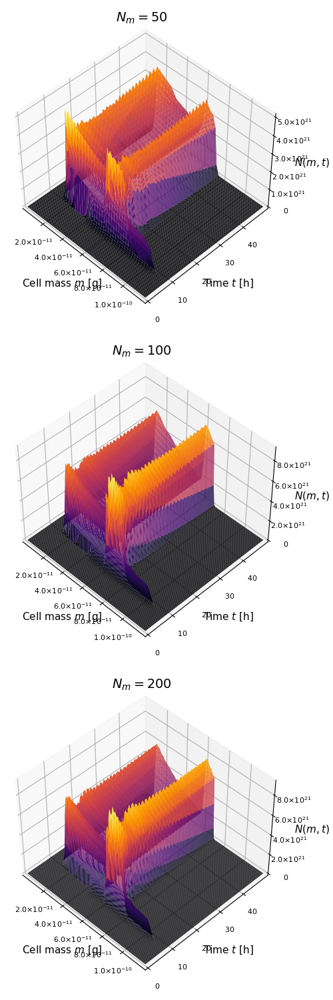

In [95]:
# switch to gr() backend for plotting 3d
# gr(html_output_format=:png)
pyplot(html_output_format=:png)

# summary plots
p_3dsurface_list = []
for (i,N_m_test) in enumerate(N_m_list)
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]

    p = plot(
        mc,
        saved_val_times_list[i][1:250],
        parsed_N_mt_list[i][1:250,:],
        st=:surface,
        camera=(45,45),
        xlabel = L"Cell mass $m$ [g]",
        ylabel = L"Time $t$ [h]",
        zlabel = L"$N(m,t)$",
        colorbar = false,
        title = L"$N_m=%$(N_m_test)$"
    )

    push!(p_3dsurface_list,p)
end
plot(
    p_3dsurface_list...,
    layout=(length(N_m_list),1),
    size = (500,length(N_m_list)*500),
    rightmargin = 20Plots.mm
)

┌ Info: Saved animation to 
│   fn = /home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m50.gif
└ @ Plots /home/kkganko/.julia/packages/Plots/lW9ll/src/animation.jl:137
┌ Info: Saved animation to 
│   fn = /home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m100.gif
└ @ Plots /home/kkganko/.julia/packages/Plots/lW9ll/src/animation.jl:137


GIF creation ran for: 736.8600965


┌ Info: Saved animation to 
│   fn = /home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m200.gif
└ @ Plots /home/kkganko/.julia/packages/Plots/lW9ll/src/animation.jl:137


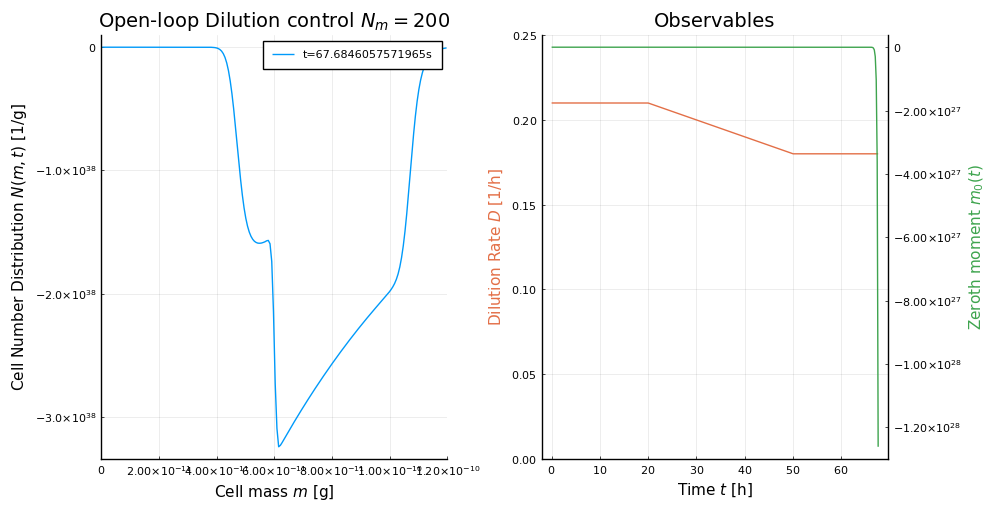

In [78]:
# animate the solutions at each N_m
time_to_completion = @elapsed begin
    gifs_list = []
    for (j,N_m_test) in enumerate(N_m_list)

        # initialize animation
        anim_variable_Nm_PBM = Animation()
        m_edges = collect(range(0.0,m_max,N_m_test+1))
        centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
        times = saved_val_times_list[j] #res[j].t
        results = parsed_N_mt_list[j]

        # go through each time point of N(m,t) and create frame for gif
        for i in 1:length(times)
            # one plot for showing changes in cell number distribution
            p1 = plot(
                centers,
                results[i,:],
                label="t=$(times[i])s",
                xlim = (0.0,m_max),
                title = L"Open-loop Dilution control $N_m = %$(N_m_test)$",
                xlabel = L"Cell mass $m$ [g]",
                ylabel = L"Cell Number Distribution $N(m,t)$ [1/g]"
            )
            # second plot for showing changes in dilution rate (open-loop controlled)
            p2 = plot(
                times[1:i],
                D_control.(times[1:i]),
                ylim = (0.0,0.25),
                xlabel = L"Time $t$ [h]",
                ylabel = L"Dilution Rate $D$ [1/h]",
                y_guidefontcolor = theme_palette(:auto)[2],
                color = 2,
                label = "",
                title = "Observables",
                rightmargin = 30Plots.mm
            )
            
            twin_p = twinx(p2)
            plot!(
                twin_p,
                times[1:i],
                res[j][end,1:i],
                ylabel = L"Zeroth moment $m_0(t)$",
                label = "",
                y_guidefontcolor = theme_palette(:auto)[3],
                color = 3
            )
            
            full_p = plot(
                p1,
                p2,
                layout = (1,2),
                size = (1000,500)
            )
            frame(anim_variable_Nm_PBM)
        end

        # save to files
        anim_FDcomp_fp = "open-loop-control-N_m$(N_m_test).gif" # cannot have special characters in this file name!!! things like : will break it
        anim_FDcomp_savepath = joinpath(pwd(), anim_FDcomp_fp)
        gif_comp = gif(anim_variable_Nm_PBM, anim_FDcomp_savepath, fps = 5);
        push!(gifs_list,gif_comp)
    end
end
println("GIF creation ran for: $(time_to_completion)")

# After chatting with Francesco and Yingjie, it became clear that the current implementation is making implicit PSSA on the change in the PBM being smaller than the adaptive timestep taken by Julia solver.

# Attempt to make the PBM mesh nodes explicit as state variables in the DAEsolver. This will require updating the parameter vector with callbacks at every time to carry over the previous time step, and subtracting from the current time step to produce the `dt` necessary for the PBM solve.

The point is, you want to make the adaptive time-stepping computation to see the PBM stability as well. Right now, the PBM solve is offloaded to the Callback as parameter vector updates.

Manual stepping of the integrator with coupling scale chosen as hyperparameter, PBM precedence, followed by DAE solve to coupling time.

In [89]:
# wrapper for PyClaw routine
py"""
# import relevant packages
import numpy as np
from scipy.stats import norm
from scipy.special import erf
from scipy.special import beta

from clawpack import pyclaw
from clawpack import riemann

# define helper functions
N_pdf_py = lambda x,mu,sigma : norm.pdf(x, loc = mu, scale = sigma)
midpt_trapz = lambda delx_list,y_c : np.dot(delx_list,y_c)
k_m = lambda S_prime, μ_m, K_m: (μ_m * S_prime)/(K_m + S_prime)

# define for both transition mass and critical mass
def m_td(S_prime,m_td0,K_td,S_l,S_h):
    if S_prime < S_l:
        return m_td0 + K_td*(S_l - S_h)
    elif (S_prime > S_l) and (S_prime < S_h):
        return m_td0 + K_td*(S_prime - S_h)
    else:
        return m_td0

# define fission rate function
@np.vectorize
def Γ(m,γ,ϵ,m_t,m_d,m_a):
    if m < m_t+m_a:
        return 0.0
    elif (m > m_t+m_a) and (m < m_d):
        return γ*np.exp(-ϵ*(m-m_d)**2)
    else:
        return γ

# partition function
def p_mm(m,m_prime,m_t,m_a,A,β):
    if m > m_prime:
        return 0.0
    elif m_prime < (m_t + m_a):
        return 0.0
    else:
        # full expression produces overflow errors, maybe do post-processing
        # A*(np.exp(β*(m-m_t)**2)+np.exp(β*(m-m_prime+m_t)**2))
        # turns out Hensen paper had typos!! should have negative sign in front of β's
        return A*(np.exp(-β*(m-m_t)**2)+np.exp(-β*(m-m_prime+m_t)**2))

def kernel_mat(m_list, N_m, m_t, m_a, A, β, Γ):

    p_mm_mat = np.zeros((N_m,N_m))

    for j in np.arange(0,N_m):
        for i in np.arange(0,N_m):
            p_mm_mat[j,i] = p_mm(m = m_list[i], m_prime = m_list[j], m_t=m_t, m_a=m_a, A=A, β=β)
    
    # np.multiply is an element-wise multiplication of the two input arrays, i.e., explicit broadcasting
    kernel_m = np.multiply(np.outer(Γ, np.ones(N_m)), p_mm_mat) # mother cell info on columns
    return kernel_m

# for generating the RHS of the solver, but also fed directly to solver
def dq_linhom_src(solver,state,dt):
    
    N_mt = state.q[0,:]
    Γ = state.aux[0,:] # Γ
    mc = state.grid.m.centers
    del_mc_list = np.multiply(np.ones(len(mc)), (mc[1]-mc[0]))

    # compute integral expression
    F = np.zeros(state.problem_data['N_m'])
    for i in range(1,state.problem_data['N_m']+1):
        F[i-1] = midpt_trapz(del_mc_list, np.multiply(state.aux[i,:], N_mt))

    # compute full RHS source term
    dq = np.empty(state.q.shape)
    D = state.problem_data['D']
    dq[0,:] = dt * (-(D + Γ) * N_mt + 2.0 * F)   
    return dq

def step_yeast_PBM_v2(S_prime, p_PBE, N_IC, dt):

    γ = p_PBE[0]                   # 1/hr, maximum fission rate, when cell m ≥ m_d
    A = p_PBE[1]                   # 1/g, partition function exponential prefactors (i.e., p(m,m'))
    S_l = p_PBE[2]                 # g/L, low substrate limit
    K_t = p_PBE[3]                 # g/g/L, proportionality constant for change in transition mass with substrate levels
    m_t0 = p_PBE[4]                # g, initial transition mass (at low substrate levels)
    m_max = p_PBE[5]               # g, maximal cell mass allowed
    Y = p_PBE[6]                   # g/g, yield coefficient for cell mass to mols substrate
    K_m = p_PBE[7]                 # g/L, Monod constant for single cell growth rate
    D = p_PBE[8]                   # 1/h, dilution rate in continuous bioreactor operation
    ϵ = p_PBE[9]                   # g^{-2}, inverse variance for fission rate when cells are in fissioning state
    β = p_PBE[10]                  # g^{-2}, another inverse variance for partition function
    S_h = p_PBE[11]                # g/L, high substrate limit
    K_d = p_PBE[12]                # g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
    m_d0 = p_PBE[13]               # g, initial critical fissioning mass (at low substrate levels)
    m_a = p_PBE[14]                # g, additional mass that mother cell must gain to start fissioning
    μ_m = p_PBE[15]                # g/h, single cell growth rate in limit of high substrate levels
    α = p_PBE[16]                  # 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
    S_f = p_PBE[17]                # g/L, feed concentration of substrate to continuous bioreactor
    N_m = int(p_PBE[18])           # number of grid points in mass domain
    
    # constant filtered substrate concentration
    m_t_test = m_td(S_prime, m_td0=m_t0, K_td=K_t, S_l=S_l, S_h=S_h)
    m_d_test = m_td(S_prime, m_td0=m_d0, K_td=K_d, S_l=S_l, S_h=S_h)
    m_ta_test = m_t_test + m_a

    # set up solver
    solver = pyclaw.SharpClawSolver1D(riemann.advection_1D_py.advection_1D)
    solver.kernel_language = 'Python'
    solver.weno_order = 5
    solver.time_integrator = 'SSP104'
    solver.dq_src = dq_linhom_src
    solver.bc_lower[0] = pyclaw.BC.extrap
    solver.bc_upper[0] = pyclaw.BC.extrap
    solver.aux_bc_lower[0]=pyclaw.BC.extrap
    solver.aux_bc_upper[0]=pyclaw.BC.extrap

    # domain
    m = pyclaw.Dimension(0.0,m_max,N_m,name='m')
    domain = pyclaw.Domain(m)
    num_aux=1+N_m
    state = pyclaw.State(domain,solver.num_eqn,num_aux)

    # parameters
    state.problem_data['u'] = k_m(S_prime,μ_m,K_m)  # growth rate
    state.problem_data['D'] = D                     # dilution rate
    state.problem_data['N_m'] = N_m                 # mesh size

    # initialize q and aux vars
    # aux vars are for holding fission rate Γ vector and kernel K(m,m',S') matrix
    mc = state.grid.m.centers
    Γ_res_test = Γ(m = mc, γ=γ, ϵ=ϵ, m_t=m_t_test, m_d=m_d_test, m_a=m_a)
    kernel_test = kernel_mat(m_list=mc, N_m=N_m, m_t=m_t_test, m_a=m_a, A=A, β=β, Γ=Γ_res_test)
    state.q[0,:] = N_IC
    state.q[0,0] = 0.0 # set lowest mass mesh point state value to 0 to help with extrapolating BC on LHS of domain
    state.aux[0,:] = Γ_res_test
    for i in range(1,N_m+1):
        state.aux[i,:] = kernel_test[:,i-1]

    # Controller
    claw = pyclaw.Controller()
    claw.keep_copy = True # saves copy of outputs to claw.frames
    claw.solution = pyclaw.Solution(state,domain)
    claw.solver = solver
    claw.tfinal = dt
    claw.output_style = 2 # for stepping to exact times desired given out_times
    #claw.num_output_times = 1
    claw.out_times = np.array([dt/2.0,dt]) # output solution only at final step
    claw.verbosity = False
    
    # run and compute zeroth order moment
    claw.run()
    del_mc_list = np.multiply(np.ones(len(claw.centers[0])), (claw.centers[0][1]-claw.centers[0][0]))
    weighted_zero_moment = midpt_trapz(del_mc_list,claw.frames[1].q[0,:] * Γ_res_test)
    return (claw.frames[1].q[0,:], weighted_zero_moment) # grab last timepoint result for N(m,t) and zeroth moment
"""

In [90]:
# ODE approach with computation offloaded to parameter vector
function substrateODEs_v2!(
        du::Vector{Float64},
        u::Vector{Float64},
        p::Vector{Any},
        t::Float64
    )
    
    # unpack only the necessary params for ODE simulations
    D = p[9]
    S_f = p[18]
    Y = p[7]
    α = p[17]
    μ_m = p[16]
    K_m = p[8]
    Γm0 = p[end]
    
#     @inbounds begin
    du[1] = D*(S_f - u[1]) - (μ_m*u[2])/(K_m+u[2])/Y * u[3]
    du[2] = α*(u[1] - u[2])
    du[3] = -D * u[3] + Γm0
#     end
end

substrateODEs_v2! (generic function with 1 method)

In [123]:
# attempt to step integrator manually, still using Julia
# https://docs.sciml.ai/DiffEqDocs/stable/basics/integrator/
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 100                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
S_0 = S_f
S_prime0 = S_0
m0 = N_00
u_0 = [
    S_0,                      # fig 4 initial substrate concentration [g/L]
    S_prime0,                 # fig 4 initial filtered substrate concentration [g/L]
    m0                        # from N_IC exact integration
]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 160.0                    # fig 4 final time [h]
tspan = (t0,tf)

# initialize to capture results for varying mesh size
N_m_list = [50,100,150]
u_res = []
saved_val_times_list = []
parsed_N_mt_list = []
timings = []

for (j,N_m_test) in enumerate(N_m_list)
    
    # update your meshing and param vector
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)

    p_test_v2[19] = N_m_test    
    p_test_v2[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))
    
    # pose the problem, no callbacks necessary, no saveat necessary (since controlling Δt)
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2,
        tstops = [20.0,50.0,100.0,130.0]
    )
    
    integrator = init(
        prob_openloop, 
        Rodas5(autodiff = false),
        reltol = 1e-8,
        abstol = 1e-8
    )
    
    # coupling time scale manually chosen
    # point is to decrease the amount of times at which coupling is forced
    # also cannot push the timestep too low as this will produce memory issues...
    Δt = 1.0e-2
    N_t = length(tspan[1]:Δt:tspan[2])
    times = Vector{Float64}(undef,N_t)
    parsed_N_mt = Matrix{Float64}(undef,N_t,N_m_test)
    u_list = Vector{Vector{Float64}}(undef,N_t)

    # sequentialism in solve, order of updates is control action, then PBM, then DAE system
    res_time = @elapsed begin 
        for (i,t) in enumerate(tspan[1]:Δt:tspan[2])

            # save some values for plotting, importantly time steps, 
            times[i] = integrator.t
            parsed_N_mt[i,:] = integrator.p[end-1]
            u_list[i] = copy(integrator.u)

            # update param vals for correct mesh
            integrator.p[9] = D_control(integrator.t)
            N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
                integrator.u[2],       # S′
                integrator.p[1:end-2], # p_PBE
                integrator.p[end-1],   # N_mt from previous timestamp
                Δt                     # dt for stepping PBM
            )
            integrator.p[end-1] = N_mt_res
            integrator.p[end] = Γm0_res
            OrdinaryDiffEq.step!(integrator, Δt, true)
        end
    end
    
    println("N_m=$(N_m_test) and N_t=$(N_t) completed in $(res_time)")
    
    # save all the necessary values
    push!(u_res, mapreduce(permutedims, vcat, u_list))
    push!(saved_val_times_list,times)
    push!(parsed_N_mt_list,parsed_N_mt)
    push!(timings,res_time)
    
end

N_m=50 and N_t=16001 completed in 182.1692315
N_m=100 and N_t=16001 completed in 391.0869815
N_m=150 and N_t=16001 completed in 762.3927375


┌ Info: Saved animation to 
│   fn = /home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m50.gif
└ @ Plots /home/kkganko/.julia/packages/Plots/lW9ll/src/animation.jl:137
┌ Info: Saved animation to 
│   fn = /home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m100.gif
└ @ Plots /home/kkganko/.julia/packages/Plots/lW9ll/src/animation.jl:137


GIF creation ran for: 42666.2756497


┌ Info: Saved animation to 
│   fn = /home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m150.gif
└ @ Plots /home/kkganko/.julia/packages/Plots/lW9ll/src/animation.jl:137


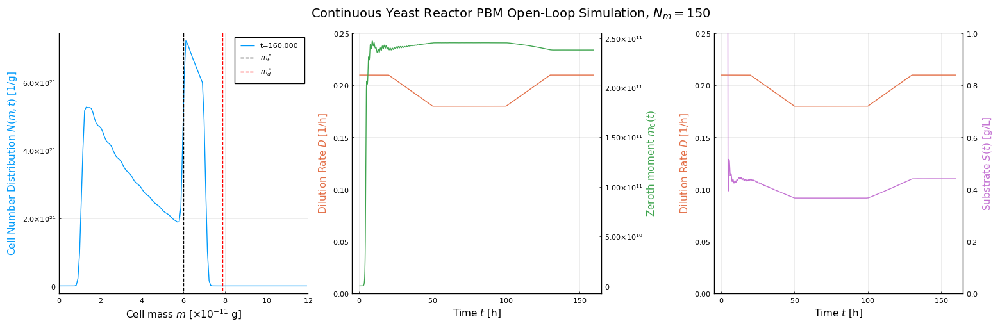

In [155]:
# animate the solutions at each N_m
# expected duration of gif in seconds = num_frames/FPS
# gr(html_output_format=:png) # not so good
pyplot(html_output_format=:png)
num_frames = 500
FPS = 10
rescale_m = 1.0e-11
time_to_completion = @elapsed begin
    gifs_list = []
    for (j,N_m_test) in enumerate(N_m_list)
        
        # initialize animation
        anim_variable_Nm_PBM = Animation()
        title = plot(
            title = L"Continuous Yeast Reactor PBM Open-Loop Simulation, $N_m = %$(N_m_test)$",
            grid = false,
            showaxis = false
        )
        m_edges = collect(range(0.0,m_max,N_m_test+1))
        centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
        times = saved_val_times_list[j] #res[j].t
        results = parsed_N_mt_list[j]
    
        # go through downsampled time points of N(m,t) and create frame for gif
        downsampled_t_ind = collect(1:Int(round(N_t / num_frames)):length(times))
        for i in downsampled_t_ind
            # one plot for showing changes in cell number distribution
            p1 = plot(
                centers ./ rescale_m,
                results[i,:],
                label=@sprintf("t=%.3f", times[i]),
                xlim = (0.0,m_max) ./ rescale_m,
                xlabel = L"Cell mass $m$ [$\times 10^{-11}$ g]",
                ylabel = L"Cell Number Distribution $N(m,t)$ [1/g]",
                y_guidefontcolor = theme_palette(:auto)[1]
            )
            
            # add lines for moving transition and critical fission boundaries
            vline!(
                p1,
                [py"m_td"(u_res[j][i,2],m_t0,K_t,S_l,S_h)] ./ rescale_m,
                label = L"$m_t^*$",
                linestyle = :dash,
                color = "black"
            )
            
            vline!(
                p1,
                [py"m_td"(u_res[j][i,2],m_d0,K_d,S_l,S_h)] ./ rescale_m,
                label = L"$m_d^*$",
                linestyle = :dash,
                color = "red"
            )
            
            # second plot for showing changes in dilution rate (open-loop controlled)
            p2 = plot(
                times[1:i],
                D_control.(times[1:i]),
                ylim = (0.0,0.25),
                xlabel = L"Time $t$ [h]",
                ylabel = L"Dilution Rate $D$ [1/h]",
                y_guidefontcolor = theme_palette(:auto)[2],
                color = 2,
                label = "",
                rightmargin = 30Plots.mm
            )
            
            twin_p = twinx(p2)
            plot!(
                twin_p,
                times[1:i],
                u_res[j][1:i,3],
                ylabel = L"Zeroth moment $m_0(t)$",
                label = "",
                y_guidefontcolor = theme_palette(:auto)[3],
                color = 3
            )
            
            # second plot for showing changes in dilution rate (open-loop controlled)
            p3 = plot(
                times[1:i],
                D_control.(times[1:i]),
                ylim = (0.0,0.25),
                xlabel = L"Time $t$ [h]",
                ylabel = L"Dilution Rate $D$ [1/h]",
                y_guidefontcolor = theme_palette(:auto)[2],
                color = 2,
                label = ""
            )
            
            twin_p2 = twinx(p3)
            plot!(
                twin_p2,
                times[1:i],
                u_res[j][1:i,1],
                ylabel = L"Substrate $S(t)$ [g/L]",
                label = "",
                y_guidefontcolor = theme_palette(:auto)[4],
                color = 4,
                ylim = (0.0,1.0)
            )
            
            full_p = plot(
                title,
                p1,
                p2,
                p3,
                layout = @layout([A{0.01h}; [B C D]]),
                titlefontsize = 14,
                size = (1500,500)
            )
                        
            frame(anim_variable_Nm_PBM)
        end

        # save to files
        anim_FDcomp_fp = "open-loop-control-N_m$(N_m_test).gif" # cannot have special characters in this file name!!! things like : will break it
        anim_FDcomp_savepath = joinpath(pwd(), anim_FDcomp_fp)
        gif_comp = gif(anim_variable_Nm_PBM, anim_FDcomp_savepath, fps = FPS);
        push!(gifs_list,gif_comp)
    end
end
println("GIF creation ran for: $(time_to_completion)")

Plots.AnimatedGif("/home/kkganko/oscillatory_bioreactor/yeast_PBM/open-loop-control-N_m50.gif")
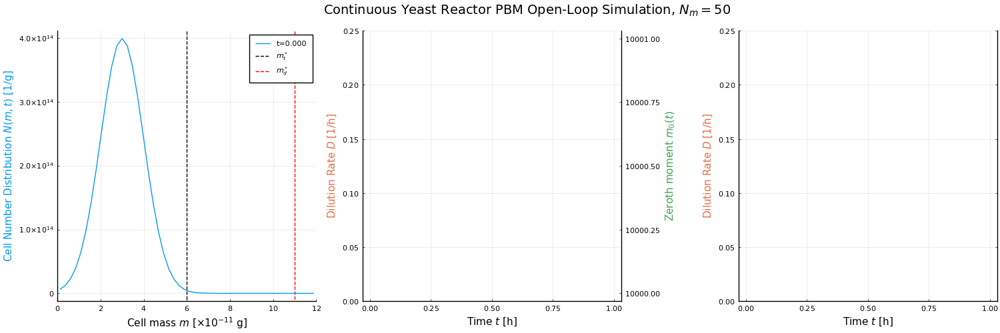

In [159]:
gifs_list[1]

# Figures for paper

What do you want to illustrate? The best description of open-loop dynamics is when you provide steady state or sustained oscillations behavior. Moreover, you want to show all the possible dynamical phenomena. 

When varying dilution rate at constant feed, this system either washes out all yeast cells, oscillates due to moving transition and critical fissioning boundaries, or has the yeast cells consume all incoming feed and saturate in growth / become restricted from further growth.

When varying substrate feed concentration, one observes a similar Hopf bifurcation.

In order to also maximize consistency with the other sections, final layout of plots will look something like: (top row) low dilution rate state vars / intermediate dilution rate state vars / high dilution rate state vars; (bottom row) cell distribution without wiggles (stable) / cell distribution with wiggles (stable oscillations) / cell distribution without wiggles (stable).

Make argument that varying substrate feed concentration has a very similar effect as changing dilution rate, b/c the oscillations are induced by substrate levels, which are influenced by dilution rate.

So 3 wide by 2 high plot.

Under these models one may choose a non-oscillatory dilution rate $D=0.1~\textrm{1/h}$, oscillatory dilution rate $D=0.25~\textrm{1/h}$, and non-oscillatory dilution rate $D=0.4~\textrm{1/h}$.

In [265]:
# attempt to step integrator manually, still using Julia
# https://docs.sciml.ai/DiffEqDocs/stable/basics/integrator/
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 100                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
S_0 = S_f
S_prime0 = S_0
m0 = N_00
u_0 = [
    S_0,                      # fig 4 initial substrate concentration [g/L]
    S_prime0,                 # fig 4 initial filtered substrate concentration [g/L]
    m0                        # from N_IC exact integration
]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 100.0                    # fig 4 final time [h]
tspan = (t0,tf)

# initialize to capture results for varying mesh size
N_m_list = [150,150,150]
D_varied = [0.1,0.25,0.4]
u_res = []
saved_val_times_list = []
parsed_N_mt_list = []
timings = []

for (j,N_m_test) in enumerate(N_m_list)
    
    # update your meshing and param vector
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)

    p_test_v2[19] = N_m_test    
    p_test_v2[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))
    
    # pose the problem, no callbacks necessary, no saveat necessary (since controlling Δt)
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2,
        tstops = [20.0,50.0,100.0,130.0]
    )
    
    integrator = init(
        prob_openloop, 
        Rodas5(autodiff = false),
        reltol = 1e-8,
        abstol = 1e-8
    )
    
    # coupling time scale manually chosen
    # point is to decrease the amount of times at which coupling is forced
    # also cannot push the timestep too low as this will produce memory issues...
    Δt = 1.0e-2
    N_t = length(tspan[1]:Δt:tspan[2])
    times = Vector{Float64}(undef,N_t)
    parsed_N_mt = Matrix{Float64}(undef,N_t,N_m_test)
    u_list = Vector{Vector{Float64}}(undef,N_t)

    # sequentialism in solve, order of updates is control action, then PBM, then DAE system
    res_time = @elapsed begin 
        for (i,t) in enumerate(tspan[1]:Δt:tspan[2])

            # save some values for plotting, importantly time steps, 
            times[i] = integrator.t
            parsed_N_mt[i,:] = integrator.p[end-1]
            u_list[i] = copy(integrator.u)

            # update param vals for correct mesh
            integrator.p[9] = D_varied[j] # D_control(integrator.t)
            N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
                integrator.u[2],       # S′
                integrator.p[1:end-2], # p_PBE
                integrator.p[end-1],   # N_mt from previous timestamp
                Δt                     # dt for stepping PBM
            )
            integrator.p[end-1] = N_mt_res
            integrator.p[end] = Γm0_res
            OrdinaryDiffEq.step!(integrator, Δt, true)
        end
    end
    
    println("N_m=$(N_m_test) and D=$(D_varied[j]) 1/h completed in $(res_time)")
    
    # save all the necessary values
    push!(u_res, mapreduce(permutedims, vcat, u_list))
    push!(saved_val_times_list,times)
    push!(parsed_N_mt_list,parsed_N_mt)
    push!(timings,res_time)
    
end

N_m=150 and D=0.1 1/h completed in 430.3970713
N_m=150 and D=0.25 1/h completed in 463.1580021
N_m=150 and D=0.4 1/h completed in 2304.504052


In [325]:
# subplot annotation functions and routines courtesy of Nathan M. Stover
function relative(f, r; sp)
    p = plot!()
    lims = f(p[sp])
    return lims[1] + r * (lims[2]-lims[1])
end
relativex(r; sp::Int=1) = relative(Plots.xlims, r; sp=sp)
relativey(r; sp::Int=1) = relative(Plots.ylims, r; sp=sp)
fontsize = 24
rescale_m = 1.0e-11
rescale_m0 = 1.0e11
rescale_N_mt = N_00 .* 1.0e17

# helper function for eliminating redundant plot labels
repeat_label(desired_ind,current_ind,label) = ifelse(desired_ind==current_ind, label, "")

p_list = []
annotations_list = ["A", "B", "C", "D", "E", "F"]
for (j,N_m_test) in enumerate(N_m_list)

    m_edges = collect(range(0.0,m_max,N_m_test+1))
    centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    times = saved_val_times_list[j] #res[j].t
    results = parsed_N_mt_list[j]
    
    # cell distribution at last time point simulated, with xlabels rescaled
    p1 = plot(
        centers ./ rescale_m,
        results[end,:] ./ rescale_N_mt,
        label= ifelse(j==1,@sprintf("t=%.1f h", times[end]),""),
        xlim = (0.0,m_max) ./ rescale_m,
        xlabel = L"Cell mass $m$ [$10^{-11}$ g]",
        ylabel = ifelse(j==1,L"Cell Number Distribution $N(m,t)$ [$10^{21}$ g$^{-1}$L$^{-1}$]",""),
        ylim = (0.0,10.0),
        legend = :topleft
    )
    # add lines for moving transition and critical fission boundaries
    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_t0,K_t,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_t^*$",""),
        linestyle = :dash,
        color = "black"
    )

    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_d0,K_d,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_d^*$",""),
        linestyle = :dash,
        color = "red"
    )
    
    # gives states info: substrate, filtered substrate, and zeroth order moment
    p2 = plot(
        times,
        u_res[j][:,3] ./ rescale_m0,
        xlabel = L"Time $t$ [h]",
        ylabel = ifelse(j==1,"Normalized Observables",""),
        label = ifelse(j==1,L"$m_0$ [$10^{11}$ L$^{-1}$]",""),
        color = 2,
        legend = :right
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,1],
        label = ifelse(j==1,L"$S$ [g/L]",""),
        color = 3,
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,2],
        label = ifelse(j==1,L"$S^\prime$ [g/L]",""),
        color = 4,
        xlim = (0.0,tf),
        ylim = (0.0,3.0),
#         yaxis=:log10
    )
    
    push!(p_list,p1)
    push!(p_list,p2)
end

# full plotting of figure
# add margins to accommodate subplot labels
full_p = plot(
    p_list[1],
    p_list[3],
    p_list[5],
    p_list[2],
    p_list[4],
    p_list[6],
    layout = (2,3),
    titlefontsize = 14,
    size = (1500,1000),
    topmargin = 15Plots.mm,
    grid=false,
    framestyle = :box,
    legendfontsize = 14
)

for k in 1:length(full_p)
    annotate!(full_p,sp=k,[(relativex(-0.05; sp=k), relativey(1.07; sp=k), text(annotations_list[k],fontsize))])
end

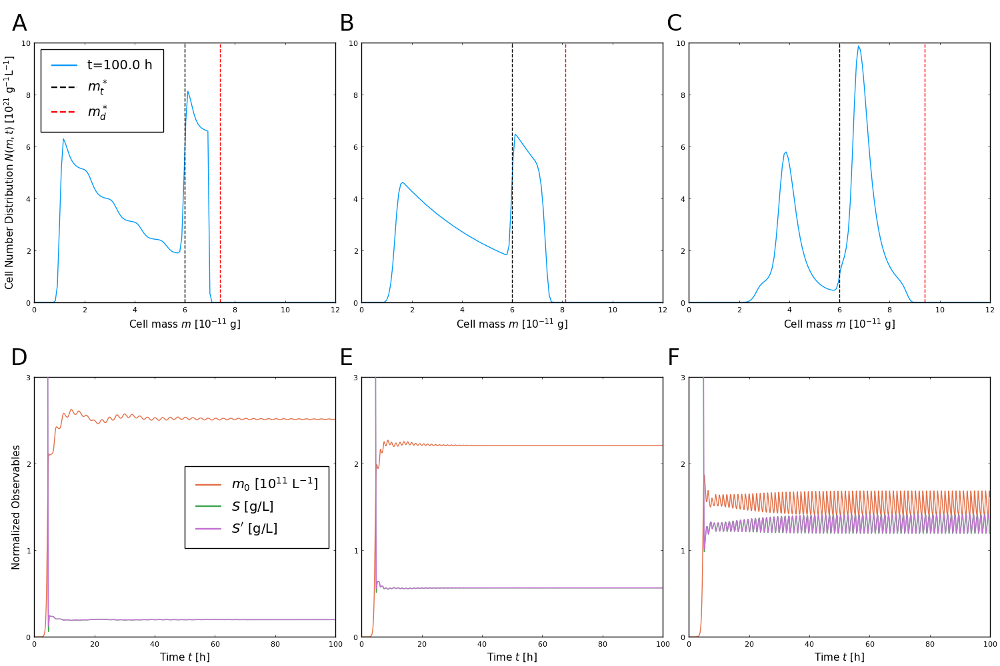

In [326]:
full_p

# Very strange... Noticing oscillation where paper did not document them to occur at. Also, noticing dampening of oscillations where paper claimed they would occur at. What's going on? Either perform bifurcation analysis or test a few more dilution rates.

In [351]:
# Usage of file I/O via JLD.jl
jld_fp_lowD = pwd() * "/openloop_D_varied_Nm_150_lowD.jld"
# openloop_D_varied_Nm_150_lowD = Dict{String, Vector}(
#     "params"=>p_test_v2,
#     "D_values"=>D_varied,
#     "solution_timepts"=>saved_val_times_list,
#     "state_values"=>u_res,
#     "cell_mass_distributions"=>parsed_N_mt_list,
#     "solution_wall_times"=>timings
# )

# # write
# jldopen(jld_fp_lowD, "w") do file
#     write(file, "openloop_D_varied_Nm_150_lowD", openloop_D_varied_Nm_150_lowD)  # alternatively, say "@write file a"
# end

# # read
# openloop_D_varied_Nm_150_lowD = jldopen(jld_fp_lowD, "r") do file
#     read(file, "openloop_D_varied_Nm_150_lowD")
# end
# display(openloop_D_varied_Nm_150_lowD)

Dict{String, Vector} with 6 entries:
  "cell_mass_distributions" => Any[[4.9929e12 6.30673e12 … 0.00300535 0.0014722…
  "state_values"            => Any[[25.0 25.0 10000.0; 25.0 25.0 9990.37; … ; 0…
  "solution_wall_times"     => Any[430.397, 463.158, 2304.5]
  "D_values"                => [0.1, 0.25, 0.4]
  "params"                  => Any[200.0, 2.82095e11, 0.1, 1.0e-13, 6.0e-11, 1.…
  "solution_timepts"        => Any[[0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.…

In [356]:
# attempt to step integrator manually, still using Julia
# https://docs.sciml.ai/DiffEqDocs/stable/basics/integrator/
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 100                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
S_0 = S_f
S_prime0 = S_0
m0 = N_00
u_0 = [
    S_0,                      # fig 4 initial substrate concentration [g/L]
    S_prime0,                 # fig 4 initial filtered substrate concentration [g/L]
    m0                        # from N_IC exact integration
]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 100.0                    # fig 4 final time [h]
tspan = (t0,tf)

# initialize to capture results for varying mesh size
N_m_list = [150,150,150]
D_varied = [0.55,0.7,0.85]
u_res = []
saved_val_times_list = []
parsed_N_mt_list = []
timings = []

for (j,N_m_test) in enumerate(N_m_list)
    
    # update your meshing and param vector
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)

    p_test_v2[19] = N_m_test    
    p_test_v2[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))
    
    # pose the problem, no callbacks necessary, no saveat necessary (since controlling Δt)
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2,
        tstops = [20.0,50.0,100.0,130.0]
    )
    
    integrator = init(
        prob_openloop, 
        Rodas5(autodiff = false),
        reltol = 1e-8,
        abstol = 1e-8
    )
    
    # coupling time scale manually chosen
    # point is to decrease the amount of times at which coupling is forced
    # also cannot push the timestep too low as this will produce memory issues...
    Δt = 1.0e-2
    N_t = length(tspan[1]:Δt:tspan[2])
    times = Vector{Float64}(undef,N_t)
    parsed_N_mt = Matrix{Float64}(undef,N_t,N_m_test)
    u_list = Vector{Vector{Float64}}(undef,N_t)

    # sequentialism in solve, order of updates is control action, then PBM, then DAE system
    res_time = @elapsed begin 
        for (i,t) in enumerate(tspan[1]:Δt:tspan[2])

            # save some values for plotting, importantly time steps, 
            times[i] = integrator.t
            parsed_N_mt[i,:] = integrator.p[end-1]
            u_list[i] = copy(integrator.u)

            # update param vals for correct mesh
            integrator.p[9] = D_varied[j] # D_control(integrator.t)
            N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
                integrator.u[2],       # S′
                integrator.p[1:end-2], # p_PBE
                integrator.p[end-1],   # N_mt from previous timestamp
                Δt                     # dt for stepping PBM
            )
            integrator.p[end-1] = N_mt_res
            integrator.p[end] = Γm0_res
            OrdinaryDiffEq.step!(integrator, Δt, true)
        end
    end
    
    println("N_m=$(N_m_test) and D=$(D_varied[j]) 1/h completed in $(res_time)")
    
    # save all the necessary values
    push!(u_res, mapreduce(permutedims, vcat, u_list))
    push!(saved_val_times_list,times)
    push!(parsed_N_mt_list,parsed_N_mt)
    push!(timings,res_time)
    
end

N_m=150 and D=0.55 1/h completed in 495.6645383
N_m=150 and D=0.7 1/h completed in 527.2137394
N_m=150 and D=0.85 1/h completed in 516.6388131


In [360]:
# subplot annotation functions and routines courtesy of Nathan M. Stover
function relative(f, r; sp)
    p = plot!()
    lims = f(p[sp])
    return lims[1] + r * (lims[2]-lims[1])
end
relativex(r; sp::Int=1) = relative(Plots.xlims, r; sp=sp)
relativey(r; sp::Int=1) = relative(Plots.ylims, r; sp=sp)
fontsize = 24
rescale_m = 1.0e-11
rescale_m0 = 1.0e11
rescale_N_mt = N_00 .* 1.0e17

# helper function for eliminating redundant plot labels
repeat_label(desired_ind,current_ind,label) = ifelse(desired_ind==current_ind, label, "")

p_list = []
annotations_list = ["A", "B", "C", "D", "E", "F"]
for (j,N_m_test) in enumerate(N_m_list)

    m_edges = collect(range(0.0,m_max,N_m_test+1))
    centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    times = saved_val_times_list[j] #res[j].t
    results = parsed_N_mt_list[j]
    
    # cell distribution at last time point simulated, with xlabels rescaled
    p1 = plot(
        centers ./ rescale_m,
        results[end,:] ./ rescale_N_mt,
        label= ifelse(j==1,@sprintf("t=%.1f h", times[end]),""),
        xlim = (0.0,m_max) ./ rescale_m,
        xlabel = L"Cell mass $m$ [$10^{-11}$ g]",
        ylabel = ifelse(j==1,L"Cell Number Distribution $N(m,t)$ [$10^{21}$ g$^{-1}$L$^{-1}$]",""),
        ylim = (0.0,10.0),
        legend = :topleft
    )
    # add lines for moving transition and critical fission boundaries
    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_t0,K_t,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_t^*$",""),
        linestyle = :dash,
        color = "black"
    )

    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_d0,K_d,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_d^*$",""),
        linestyle = :dash,
        color = "red"
    )
    
    # gives states info: substrate, filtered substrate, and zeroth order moment
    p2 = plot(
        times,
        u_res[j][:,3] ./ rescale_m0,
        xlabel = L"Time $t$ [h]",
        ylabel = ifelse(j==1,"Normalized Observables",""),
        label = ifelse(j==1,L"$m_0$ [$10^{11}$ L$^{-1}$]",""),
        color = 2,
        legend = :bottomright
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,1],
        label = ifelse(j==1,L"$S$ [g/L]",""),
        color = 3,
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,2],
        label = ifelse(j==1,L"$S^\prime$ [g/L]",""),
        color = 4,
        xlim = (0.0,tf),
        ylim = (0.0,3.0),
#         yaxis=:log10
    )
    
    push!(p_list,p1)
    push!(p_list,p2)
end

# full plotting of figure
# add margins to accommodate subplot labels
full_p = plot(
    p_list[1],
    p_list[3],
    p_list[5],
    p_list[2],
    p_list[4],
    p_list[6],
    layout = (2,3),
    titlefontsize = 14,
    size = (1500,1000),
    topmargin = 15Plots.mm,
    grid=false,
    framestyle = :box,
    legendfontsize = 14
)

for k in 1:length(full_p)
    annotate!(full_p,sp=k,[(relativex(-0.05; sp=k), relativey(1.07; sp=k), text(annotations_list[k],fontsize))])
end

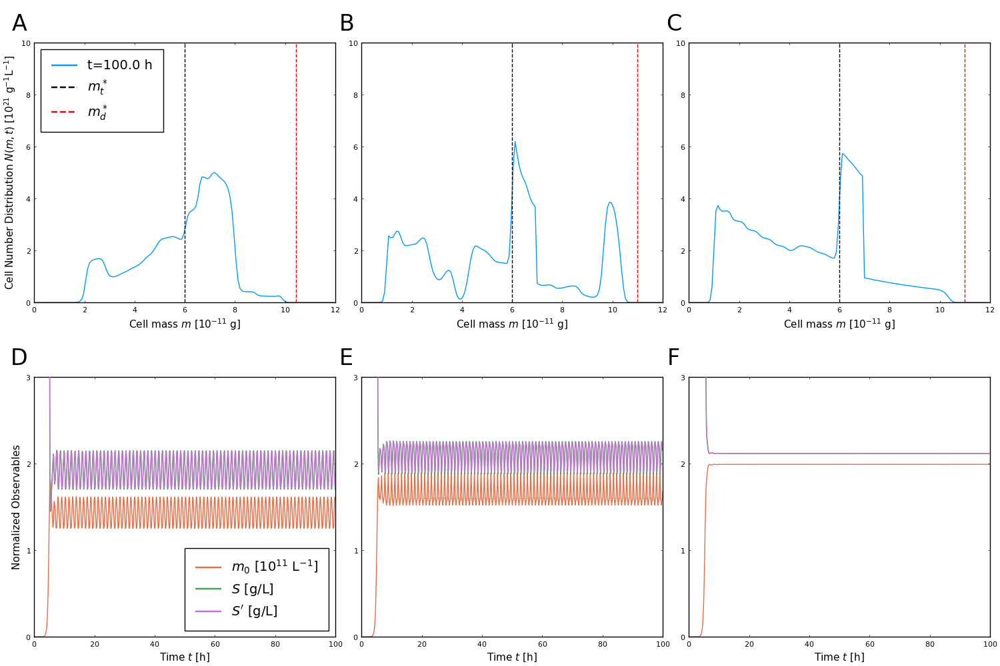

In [361]:
full_p

In [359]:
# Usage of file I/O via JLD.jl
jld_fp_highD = pwd() * "/openloop_D_varied_Nm_150_highD.jld"
# openloop_D_varied_Nm_150_highD = Dict{String, Vector}(
#     "params"=>p_test_v2,
#     "D_values"=>D_varied,
#     "solution_timepts"=>saved_val_times_list,
#     "state_values"=>u_res,
#     "cell_mass_distributions"=>parsed_N_mt_list,
#     "solution_wall_times"=>timings
# )

# # write
# jldopen(jld_fp_highD, "w") do file
#     write(file, "openloop_D_varied_Nm_150_highD", openloop_D_varied_Nm_150_highD)  # alternatively, say "@write file a"
# end

# # read
# openloop_D_varied_Nm_150_highD = jldopen(jld_fp_highD, "r") do file
#     read(file, "openloop_D_varied_Nm_150_highD")
# end
# display(openloop_D_varied_Nm_150_highD)

# The discrepancy may be explained by coupling time constant used. It is possible that coupling the solvers at an arbitrary timestep may be changing the dynamics of the system, e.g., adding a delay in information propagation.

# Simulate the system at a smaller coupling time to see if the dynamics change compared to the above plots.

In [362]:
# attempt to step integrator manually, still using Julia
# https://docs.sciml.ai/DiffEqDocs/stable/basics/integrator/
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 100                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
S_0 = S_f
S_prime0 = S_0
m0 = N_00
u_0 = [
    S_0,                      # fig 4 initial substrate concentration [g/L]
    S_prime0,                 # fig 4 initial filtered substrate concentration [g/L]
    m0                        # from N_IC exact integration
]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 100.0                    # fig 4 final time [h]
tspan = (t0,tf)

# initialize to capture results for varying mesh size
N_m_list = [150,150,150]
D_varied = [0.55,0.7,0.85]
u_res = []
saved_val_times_list = []
parsed_N_mt_list = []
timings = []

for (j,N_m_test) in enumerate(N_m_list)
    
    # update your meshing and param vector
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)

    p_test_v2[19] = N_m_test    
    p_test_v2[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))
    
    # pose the problem, no callbacks necessary, no saveat necessary (since controlling Δt)
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2,
        tstops = [20.0,50.0,100.0,130.0]
    )
    
    integrator = init(
        prob_openloop, 
        Rodas5(autodiff = false),
        reltol = 1e-8,
        abstol = 1e-8
    )
    
    # coupling time scale manually chosen
    # point is to decrease the amount of times at which coupling is forced
    # also cannot push the timestep too low as this will produce memory issues...
    Δt = 0.5e-2
    N_t = length(tspan[1]:Δt:tspan[2])
    times = Vector{Float64}(undef,N_t)
    parsed_N_mt = Matrix{Float64}(undef,N_t,N_m_test)
    u_list = Vector{Vector{Float64}}(undef,N_t)

    # sequentialism in solve, order of updates is control action, then PBM, then DAE system
    res_time = @elapsed begin 
        for (i,t) in enumerate(tspan[1]:Δt:tspan[2])

            # save some values for plotting, importantly time steps, 
            times[i] = integrator.t
            parsed_N_mt[i,:] = integrator.p[end-1]
            u_list[i] = copy(integrator.u)

            # update param vals for correct mesh
            integrator.p[9] = D_varied[j] # D_control(integrator.t)
            N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
                integrator.u[2],       # S′
                integrator.p[1:end-2], # p_PBE
                integrator.p[end-1],   # N_mt from previous timestamp
                Δt                     # dt for stepping PBM
            )
            integrator.p[end-1] = N_mt_res
            integrator.p[end] = Γm0_res
            OrdinaryDiffEq.step!(integrator, Δt, true)
        end
    end
    
    println("N_m=$(N_m_test) and D=$(D_varied[j]) 1/h completed in $(res_time)")
    
    # save all the necessary values
    push!(u_res, mapreduce(permutedims, vcat, u_list))
    push!(saved_val_times_list,times)
    push!(parsed_N_mt_list,parsed_N_mt)
    push!(timings,res_time)
    
end

N_m=150 and D=0.55 1/h completed in 896.4740175
N_m=150 and D=0.7 1/h completed in 1027.0044995
N_m=150 and D=0.85 1/h completed in 978.8372983


In [363]:
# subplot annotation functions and routines courtesy of Nathan M. Stover
function relative(f, r; sp)
    p = plot!()
    lims = f(p[sp])
    return lims[1] + r * (lims[2]-lims[1])
end
relativex(r; sp::Int=1) = relative(Plots.xlims, r; sp=sp)
relativey(r; sp::Int=1) = relative(Plots.ylims, r; sp=sp)
fontsize = 24
rescale_m = 1.0e-11
rescale_m0 = 1.0e11
rescale_N_mt = N_00 .* 1.0e17

# helper function for eliminating redundant plot labels
repeat_label(desired_ind,current_ind,label) = ifelse(desired_ind==current_ind, label, "")

p_list = []
annotations_list = ["A", "B", "C", "D", "E", "F"]
for (j,N_m_test) in enumerate(N_m_list)

    m_edges = collect(range(0.0,m_max,N_m_test+1))
    centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    times = saved_val_times_list[j] #res[j].t
    results = parsed_N_mt_list[j]
    
    # cell distribution at last time point simulated, with xlabels rescaled
    p1 = plot(
        centers ./ rescale_m,
        results[end,:] ./ rescale_N_mt,
        label= ifelse(j==1,@sprintf("t=%.1f h", times[end]),""),
        xlim = (0.0,m_max) ./ rescale_m,
        xlabel = L"Cell mass $m$ [$10^{-11}$ g]",
        ylabel = ifelse(j==1,L"Cell Number Distribution $N(m,t)$ [$10^{21}$ g$^{-1}$L$^{-1}$]",""),
        ylim = (0.0,10.0),
        legend = :topleft
    )
    # add lines for moving transition and critical fission boundaries
    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_t0,K_t,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_t^*$",""),
        linestyle = :dash,
        color = "black"
    )

    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_d0,K_d,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_d^*$",""),
        linestyle = :dash,
        color = "red"
    )
    
    # gives states info: substrate, filtered substrate, and zeroth order moment
    p2 = plot(
        times,
        u_res[j][:,3] ./ rescale_m0,
        xlabel = L"Time $t$ [h]",
        ylabel = ifelse(j==1,"Normalized Observables",""),
        label = ifelse(j==1,L"$m_0$ [$10^{11}$ L$^{-1}$]",""),
        color = 2,
        legend = :bottomright
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,1],
        label = ifelse(j==1,L"$S$ [g/L]",""),
        color = 3,
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,2],
        label = ifelse(j==1,L"$S^\prime$ [g/L]",""),
        color = 4,
        xlim = (0.0,tf),
        ylim = (0.0,3.0),
#         yaxis=:log10
    )
    
    push!(p_list,p1)
    push!(p_list,p2)
end

# full plotting of figure
# add margins to accommodate subplot labels
full_p = plot(
    p_list[1],
    p_list[3],
    p_list[5],
    p_list[2],
    p_list[4],
    p_list[6],
    layout = (2,3),
    titlefontsize = 14,
    size = (1500,1000),
    topmargin = 15Plots.mm,
    grid=false,
    framestyle = :box,
    legendfontsize = 14
)

for k in 1:length(full_p)
    annotate!(full_p,sp=k,[(relativex(-0.05; sp=k), relativey(1.07; sp=k), text(annotations_list[k],fontsize))])
end

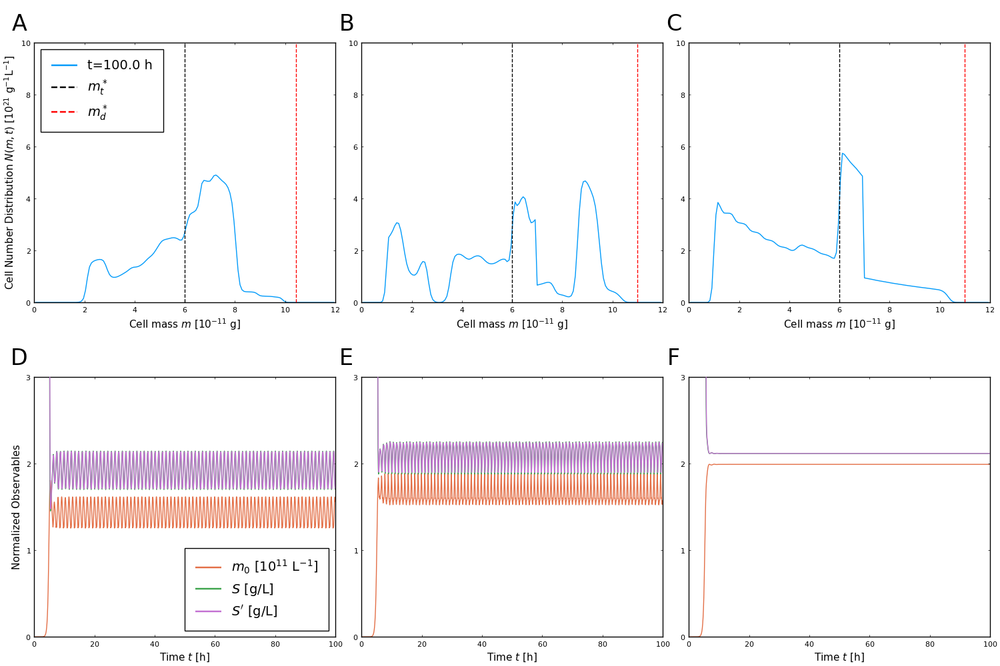

In [364]:
full_p

# Comparing to the plots above, it does not look like changing the coupling time introduces differences in the dynamics. One can now try changing the discretization of the mesh to see if similar results are obtained at the same dilution rates.

In [365]:
# attempt to step integrator manually, still using Julia
# https://docs.sciml.ai/DiffEqDocs/stable/basics/integrator/
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 100                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
S_0 = S_f
S_prime0 = S_0
m0 = N_00
u_0 = [
    S_0,                      # fig 4 initial substrate concentration [g/L]
    S_prime0,                 # fig 4 initial filtered substrate concentration [g/L]
    m0                        # from N_IC exact integration
]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 100.0                    # fig 4 final time [h]
tspan = (t0,tf)

# initialize to capture results for varying mesh size
N_m_list = [50,50,50]
D_varied = [0.55,0.7,0.85]
u_res = []
saved_val_times_list = []
parsed_N_mt_list = []
timings = []

for (j,N_m_test) in enumerate(N_m_list)
    
    # update your meshing and param vector
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)

    p_test_v2[19] = N_m_test    
    p_test_v2[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))
    
    # pose the problem, no callbacks necessary, no saveat necessary (since controlling Δt)
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2,
        tstops = [20.0,50.0,100.0,130.0]
    )
    
    integrator = init(
        prob_openloop, 
        Rodas5(autodiff = false),
        reltol = 1e-8,
        abstol = 1e-8
    )
    
    # coupling time scale manually chosen
    # point is to decrease the amount of times at which coupling is forced
    # also cannot push the timestep too low as this will produce memory issues...
    Δt = 0.5e-2
    N_t = length(tspan[1]:Δt:tspan[2])
    times = Vector{Float64}(undef,N_t)
    parsed_N_mt = Matrix{Float64}(undef,N_t,N_m_test)
    u_list = Vector{Vector{Float64}}(undef,N_t)

    # sequentialism in solve, order of updates is control action, then PBM, then DAE system
    res_time = @elapsed begin 
        for (i,t) in enumerate(tspan[1]:Δt:tspan[2])

            # save some values for plotting, importantly time steps, 
            times[i] = integrator.t
            parsed_N_mt[i,:] = integrator.p[end-1]
            u_list[i] = copy(integrator.u)

            # update param vals for correct mesh
            integrator.p[9] = D_varied[j] # D_control(integrator.t)
            N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
                integrator.u[2],       # S′
                integrator.p[1:end-2], # p_PBE
                integrator.p[end-1],   # N_mt from previous timestamp
                Δt                     # dt for stepping PBM
            )
            integrator.p[end-1] = N_mt_res
            integrator.p[end] = Γm0_res
            OrdinaryDiffEq.step!(integrator, Δt, true)
        end
    end
    
    println("N_m=$(N_m_test) and D=$(D_varied[j]) 1/h completed in $(res_time)")
    
    # save all the necessary values
    push!(u_res, mapreduce(permutedims, vcat, u_list))
    push!(saved_val_times_list,times)
    push!(parsed_N_mt_list,parsed_N_mt)
    push!(timings,res_time)
    
end

N_m=50 and D=0.55 1/h completed in 444.5949798
N_m=50 and D=0.7 1/h completed in 298.254267
N_m=50 and D=0.85 1/h completed in 246.3476858


In [366]:
# subplot annotation functions and routines courtesy of Nathan M. Stover
function relative(f, r; sp)
    p = plot!()
    lims = f(p[sp])
    return lims[1] + r * (lims[2]-lims[1])
end
relativex(r; sp::Int=1) = relative(Plots.xlims, r; sp=sp)
relativey(r; sp::Int=1) = relative(Plots.ylims, r; sp=sp)
fontsize = 24
rescale_m = 1.0e-11
rescale_m0 = 1.0e11
rescale_N_mt = N_00 .* 1.0e17

# helper function for eliminating redundant plot labels
repeat_label(desired_ind,current_ind,label) = ifelse(desired_ind==current_ind, label, "")

p_list = []
annotations_list = ["A", "B", "C", "D", "E", "F"]
for (j,N_m_test) in enumerate(N_m_list)

    m_edges = collect(range(0.0,m_max,N_m_test+1))
    centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    times = saved_val_times_list[j] #res[j].t
    results = parsed_N_mt_list[j]
    
    # cell distribution at last time point simulated, with xlabels rescaled
    p1 = plot(
        centers ./ rescale_m,
        results[end,:] ./ rescale_N_mt,
        label= ifelse(j==1,@sprintf("t=%.1f h", times[end]),""),
        xlim = (0.0,m_max) ./ rescale_m,
        xlabel = L"Cell mass $m$ [$10^{-11}$ g]",
        ylabel = ifelse(j==1,L"Cell Number Distribution $N(m,t)$ [$10^{21}$ g$^{-1}$L$^{-1}$]",""),
        ylim = (0.0,10.0),
        legend = :topleft
    )
    # add lines for moving transition and critical fission boundaries
    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_t0,K_t,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_t^*$",""),
        linestyle = :dash,
        color = "black"
    )

    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_d0,K_d,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_d^*$",""),
        linestyle = :dash,
        color = "red"
    )
    
    # gives states info: substrate, filtered substrate, and zeroth order moment
    p2 = plot(
        times,
        u_res[j][:,3] ./ rescale_m0,
        xlabel = L"Time $t$ [h]",
        ylabel = ifelse(j==1,"Normalized Observables",""),
        label = ifelse(j==1,L"$m_0$ [$10^{11}$ L$^{-1}$]",""),
        color = 2,
        legend = :bottomright
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,1],
        label = ifelse(j==1,L"$S$ [g/L]",""),
        color = 3,
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,2],
        label = ifelse(j==1,L"$S^\prime$ [g/L]",""),
        color = 4,
        xlim = (0.0,tf),
        ylim = (0.0,3.0),
#         yaxis=:log10
    )
    
    push!(p_list,p1)
    push!(p_list,p2)
end

# full plotting of figure
# add margins to accommodate subplot labels
full_p = plot(
    p_list[1],
    p_list[3],
    p_list[5],
    p_list[2],
    p_list[4],
    p_list[6],
    layout = (2,3),
    titlefontsize = 14,
    size = (1500,1000),
    topmargin = 15Plots.mm,
    grid=false,
    framestyle = :box,
    legendfontsize = 14
)

for k in 1:length(full_p)
    annotate!(full_p,sp=k,[(relativex(-0.05; sp=k), relativey(1.07; sp=k), text(annotations_list[k],fontsize))])
end

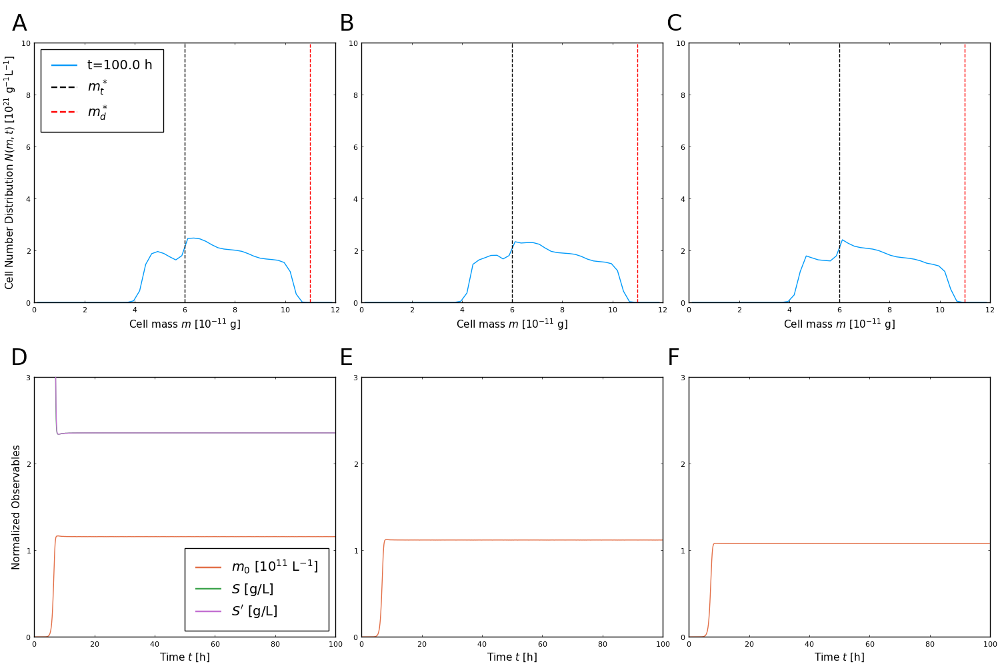

In [367]:
full_p

# The dynamics change may also be an artefact of how the system is discretized. The Zhang2001 paper report using finite elements and orthogonal collocation.

In [368]:
# attempt to step integrator manually, still using Julia
# https://docs.sciml.ai/DiffEqDocs/stable/basics/integrator/
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 100                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
S_0 = S_f
S_prime0 = S_0
m0 = N_00
u_0 = [
    S_0,                      # fig 4 initial substrate concentration [g/L]
    S_prime0,                 # fig 4 initial filtered substrate concentration [g/L]
    m0                        # from N_IC exact integration
]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 100.0                    # fig 4 final time [h]
tspan = (t0,tf)

# initialize to capture results for varying mesh size
N_m_list = [150,150,150,150]
D_varied = [0.25,0.45,0.65,0.85]
u_res = []
saved_val_times_list = []
parsed_N_mt_list = []
timings = []

for (j,N_m_test) in enumerate(N_m_list)
    
    # update your meshing and param vector
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)

    p_test_v2[19] = N_m_test    
    p_test_v2[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))
    
    # pose the problem, no callbacks necessary, no saveat necessary (since controlling Δt)
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2,
        tstops = [20.0,50.0,100.0,130.0]
    )
    
    integrator = init(
        prob_openloop, 
        Rodas5(autodiff = false),
        reltol = 1e-8,
        abstol = 1e-8
    )
    
    # coupling time scale manually chosen
    # point is to decrease the amount of times at which coupling is forced
    # also cannot push the timestep too low as this will produce memory issues...
    Δt = 1.0e-2
    N_t = length(tspan[1]:Δt:tspan[2])
    times = Vector{Float64}(undef,N_t)
    parsed_N_mt = Matrix{Float64}(undef,N_t,N_m_test)
    u_list = Vector{Vector{Float64}}(undef,N_t)

    # sequentialism in solve, order of updates is control action, then PBM, then DAE system
    res_time = @elapsed begin 
        for (i,t) in enumerate(tspan[1]:Δt:tspan[2])

            # save some values for plotting, importantly time steps, 
            times[i] = integrator.t
            parsed_N_mt[i,:] = integrator.p[end-1]
            u_list[i] = copy(integrator.u)

            # update param vals for correct mesh
            integrator.p[9] = D_varied[j] # D_control(integrator.t)
            N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
                integrator.u[2],       # S′
                integrator.p[1:end-2], # p_PBE
                integrator.p[end-1],   # N_mt from previous timestamp
                Δt                     # dt for stepping PBM
            )
            integrator.p[end-1] = N_mt_res
            integrator.p[end] = Γm0_res
            OrdinaryDiffEq.step!(integrator, Δt, true)
        end
    end
    
    println("N_m=$(N_m_test) and D=$(D_varied[j]) 1/h completed in $(res_time)")
    
    # save all the necessary values
    push!(u_res, mapreduce(permutedims, vcat, u_list))
    push!(saved_val_times_list,times)
    push!(parsed_N_mt_list,parsed_N_mt)
    push!(timings,res_time)
    
end

N_m=150 and D=0.25 1/h completed in 471.4358533
N_m=150 and D=0.45 1/h completed in 477.6259903
N_m=150 and D=0.65 1/h completed in 495.367656
N_m=150 and D=0.85 1/h completed in 531.5335062


In [371]:
# subplot annotation functions and routines courtesy of Nathan M. Stover
function relative(f, r; sp)
    p = plot!()
    lims = f(p[sp])
    return lims[1] + r * (lims[2]-lims[1])
end
relativex(r; sp::Int=1) = relative(Plots.xlims, r; sp=sp)
relativey(r; sp::Int=1) = relative(Plots.ylims, r; sp=sp)
fontsize = 24
rescale_m = 1.0e-11
rescale_m0 = 1.0e11
rescale_N_mt = N_00 .* 1.0e17

# helper function for eliminating redundant plot labels
repeat_label(desired_ind,current_ind,label) = ifelse(desired_ind==current_ind, label, "")

p_list = []
annotations_list = ["A", "B", "C", "D", "E", "F", "G", "H"]
for (j,N_m_test) in enumerate(N_m_list)

    m_edges = collect(range(0.0,m_max,N_m_test+1))
    centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    times = saved_val_times_list[j] #res[j].t
    results = parsed_N_mt_list[j]
    
    # cell distribution at last time point simulated, with xlabels rescaled
    p1 = plot(
        centers ./ rescale_m,
        results[end,:] ./ rescale_N_mt,
        label= ifelse(j==1,@sprintf("t=%.1f h", times[end]),""),
        xlim = (0.0,m_max) ./ rescale_m,
        xlabel = L"Cell mass $m$ [$10^{-11}$ g]",
        ylabel = ifelse(j==1,L"Cell Number Distribution $N(m,t)$ [$10^{21}$ g$^{-1}$L$^{-1}$]",""),
        ylim = (0.0,10.0),
        legend = :topleft
    )
    # add lines for moving transition and critical fission boundaries
    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_t0,K_t,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_t^*$",""),
        linestyle = :dash,
        color = "black"
    )

    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_d0,K_d,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_d^*$",""),
        linestyle = :dash,
        color = "red"
    )
    
    # gives states info: substrate, filtered substrate, and zeroth order moment
    p2 = plot(
        times,
        u_res[j][:,3] ./ rescale_m0,
        xlabel = L"Time $t$ [h]",
        ylabel = ifelse(j==1,"Normalized Observables",""),
        label = ifelse(j==1,L"$m_0$ [$10^{11}$ L$^{-1}$]",""),
        color = 2,
        legend = :right
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,1],
        label = ifelse(j==1,L"$S$ [g/L]",""),
        color = 3,
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,2],
        label = ifelse(j==1,L"$S^\prime$ [g/L]",""),
        color = 4,
        xlim = (0.0,tf),
        ylim = (0.0,3.0),
#         yaxis=:log10
    )
    
    push!(p_list,p1)
    push!(p_list,p2)
end

# full plotting of figure
# add margins to accommodate subplot labels
full_p = plot(
    p_list[1],
    p_list[3],
    p_list[5],
    p_list[7],
    p_list[2],
    p_list[4],
    p_list[6],
    p_list[8],
    layout = (2,4),
    titlefontsize = 14,
    size = (2000,1000),
    topmargin = 15Plots.mm,
    grid=false,
    framestyle = :box,
    legendfontsize = 14
)

for k in 1:length(full_p)
    annotate!(full_p,sp=k,[(relativex(-0.05; sp=k), relativey(1.07; sp=k), text(annotations_list[k],fontsize))])
end

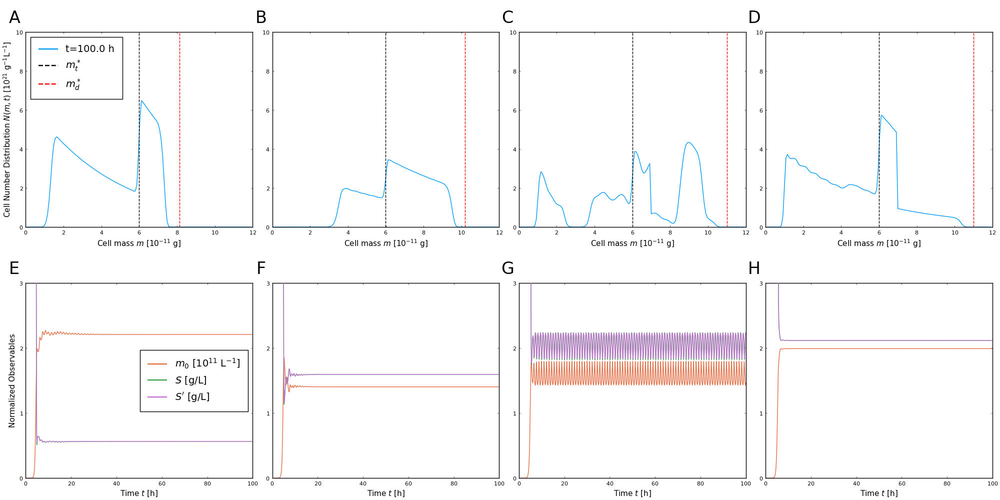

In [372]:
full_p

In [374]:
# Usage of file I/O via JLD.jl
jld_fp_figureplots = pwd() * "/openloop_D_varied_Nm_150_allD.jld"
# openloop_D_varied_Nm_150_allD = Dict{String, Vector}(
#     "params"=>p_test_v2,
#     "D_values"=>D_varied,
#     "solution_timepts"=>saved_val_times_list,
#     "state_values"=>u_res,
#     "cell_mass_distributions"=>parsed_N_mt_list,
#     "solution_wall_times"=>timings
# )

# # write
# jldopen(jld_fp_figureplots, "w") do file
#     write(file, "openloop_D_varied_Nm_150_allD", openloop_D_varied_Nm_150_allD)  # alternatively, say "@write file a"
# end

# # read
# openloop_D_varied_Nm_150_allD = jldopen(jld_fp_figureplots, "r") do file
#     read(file, "openloop_D_varied_Nm_150_allD")
# end
# display(openloop_D_varied_Nm_150_allD)

Dict{String, Vector} with 6 entries:
  "cell_mass_distributions" => Any[[4.9929e12 6.30673e12 … 0.00300535 0.0014722…
  "state_values"            => Any[[25.0 25.0 10000.0; 25.0 25.0 9975.4; … ; 0.…
  "solution_wall_times"     => Any[471.436, 477.626, 495.368, 531.534]
  "D_values"                => [0.25, 0.45, 0.65, 0.85]
  "params"                  => Any[200.0, 2.82095e11, 0.1, 1.0e-13, 6.0e-11, 1.…
  "solution_timepts"        => Any[[0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.…

# Other papers in series argue that IC changes dynamical behavior. You can put this to the test by varying the IC to simulate two Gaussian peaks (see if cell cycle synchrony argument holds up).

In [381]:
# attempt to step integrator manually, still using Julia
# https://docs.sciml.ai/DiffEqDocs/stable/basics/integrator/
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 100                     # 19) -, number of grid points in mass domain

# IC conditions
μ_01 = 4.0e-11                 # g, initial cell mass distribution mean daughter cell peak
μ_02 = 7.0e-11                 # g, initial cell mass distribution mean mother cell peak
σ_0 = 1.0e-11                  # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                   # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_01,σ_0) ./2 .+ N_00 .* N_pdf(mc,μ_02,σ_0) ./2
S_0 = S_f
S_prime0 = S_0
m0 = N_00
u_0 = [
    S_0,                      # fig 4 initial substrate concentration [g/L]
    S_prime0,                 # fig 4 initial filtered substrate concentration [g/L]
    m0                        # from N_IC exact integration
]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 100.0                    # fig 4 final time [h]
tspan = (t0,tf)

# initialize to capture results for varying mesh size
N_m_list = [150,150,150,150]
D_varied = [0.25,0.45,0.65,0.85]
u_res = []
saved_val_times_list = []
parsed_N_mt_list = []
timings = []

for (j,N_m_test) in enumerate(N_m_list)
    
    # update your meshing and param vector
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)

    p_test_v2[19] = N_m_test    
    p_test_v2[20] = N_00 .* N_pdf(mc,μ_01,σ_0) ./2 .+ N_00 .* N_pdf(mc,μ_02,σ_0) ./2
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))
    
    # pose the problem, no callbacks necessary, no saveat necessary (since controlling Δt)
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2,
        tstops = [20.0,50.0,100.0,130.0]
    )
    
    integrator = init(
        prob_openloop, 
        Rodas5(autodiff = false),
        reltol = 1e-8,
        abstol = 1e-8
    )
    
    # coupling time scale manually chosen
    # point is to decrease the amount of times at which coupling is forced
    # also cannot push the timestep too low as this will produce memory issues...
    Δt = 1.0e-2
    N_t = length(tspan[1]:Δt:tspan[2])
    times = Vector{Float64}(undef,N_t)
    parsed_N_mt = Matrix{Float64}(undef,N_t,N_m_test)
    u_list = Vector{Vector{Float64}}(undef,N_t)

    # sequentialism in solve, order of updates is control action, then PBM, then DAE system
    res_time = @elapsed begin 
        for (i,t) in enumerate(tspan[1]:Δt:tspan[2])

            # save some values for plotting, importantly time steps, 
            times[i] = integrator.t
            parsed_N_mt[i,:] = integrator.p[end-1]
            u_list[i] = copy(integrator.u)

            # update param vals for correct mesh
            integrator.p[9] = D_varied[j] # D_control(integrator.t)
            N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
                integrator.u[2],       # S′
                integrator.p[1:end-2], # p_PBE
                integrator.p[end-1],   # N_mt from previous timestamp
                Δt                     # dt for stepping PBM
            )
            integrator.p[end-1] = N_mt_res
            integrator.p[end] = Γm0_res
            OrdinaryDiffEq.step!(integrator, Δt, true)
        end
    end
    
    println("N_m=$(N_m_test) and D=$(D_varied[j]) 1/h completed in $(res_time)")
    
    # save all the necessary values
    push!(u_res, mapreduce(permutedims, vcat, u_list))
    push!(saved_val_times_list,times)
    push!(parsed_N_mt_list,parsed_N_mt)
    push!(timings,res_time)
    
end

N_m=150 and D=0.25 1/h completed in 481.097615
N_m=150 and D=0.45 1/h completed in 520.5011213
N_m=150 and D=0.65 1/h completed in 504.6642348
N_m=150 and D=0.85 1/h completed in 497.0478765


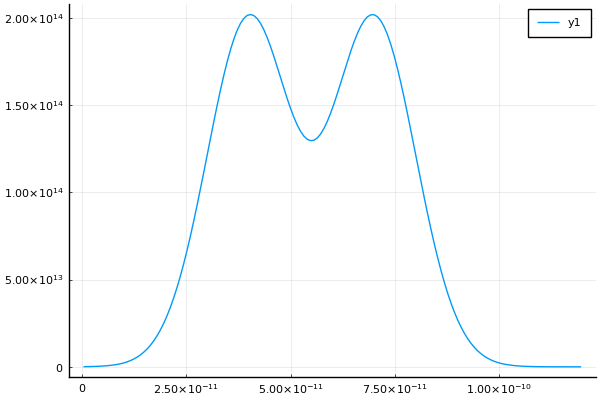

In [395]:
# visualize IC
N_m_test = 150
m_edges = collect(range(0.0,m_max,N_m_test+1))
centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
plot(
    centers,
    parsed_N_mt_list[1][1,:]
)

In [382]:
# subplot annotation functions and routines courtesy of Nathan M. Stover
function relative(f, r; sp)
    p = plot!()
    lims = f(p[sp])
    return lims[1] + r * (lims[2]-lims[1])
end
relativex(r; sp::Int=1) = relative(Plots.xlims, r; sp=sp)
relativey(r; sp::Int=1) = relative(Plots.ylims, r; sp=sp)
fontsize = 24
rescale_m = 1.0e-11
rescale_m0 = 1.0e11
rescale_N_mt = N_00 .* 1.0e17

# helper function for eliminating redundant plot labels
repeat_label(desired_ind,current_ind,label) = ifelse(desired_ind==current_ind, label, "")

p_list = []
annotations_list = ["A", "B", "C", "D", "E", "F", "G", "H"]
for (j,N_m_test) in enumerate(N_m_list)

    m_edges = collect(range(0.0,m_max,N_m_test+1))
    centers = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    times = saved_val_times_list[j] #res[j].t
    results = parsed_N_mt_list[j]
    
    # cell distribution at last time point simulated, with xlabels rescaled
    p1 = plot(
        centers ./ rescale_m,
        results[end,:] ./ rescale_N_mt,
        label= ifelse(j==1,@sprintf("t=%.1f h", times[end]),""),
        xlim = (0.0,m_max) ./ rescale_m,
        xlabel = L"Cell mass $m$ [$10^{-11}$ g]",
        ylabel = ifelse(j==1,L"Cell Number Distribution $N(m,t)$ [$10^{21}$ g$^{-1}$L$^{-1}$]",""),
        ylim = (0.0,10.0),
        legend = :topleft
    )
    # add lines for moving transition and critical fission boundaries
    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_t0,K_t,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_t^*$",""),
        linestyle = :dash,
        color = "black"
    )

    vline!(
        p1,
        [py"m_td"(u_res[j][end,2],m_d0,K_d,S_l,S_h)] ./ rescale_m,
        label = ifelse(j==1,L"$m_d^*$",""),
        linestyle = :dash,
        color = "red"
    )
    
    # gives states info: substrate, filtered substrate, and zeroth order moment
    p2 = plot(
        times,
        u_res[j][:,3] ./ rescale_m0,
        xlabel = L"Time $t$ [h]",
        ylabel = ifelse(j==1,"Normalized Observables",""),
        label = ifelse(j==1,L"$m_0$ [$10^{11}$ L$^{-1}$]",""),
        color = 2,
        legend = :right
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,1],
        label = ifelse(j==1,L"$S$ [g/L]",""),
        color = 3,
    )
    
    plot!(
        p2,
        times,
        u_res[j][:,2],
        label = ifelse(j==1,L"$S^\prime$ [g/L]",""),
        color = 4,
        xlim = (0.0,tf),
        ylim = (0.0,3.0),
#         yaxis=:log10
    )
    
    push!(p_list,p1)
    push!(p_list,p2)
end

# full plotting of figure
# add margins to accommodate subplot labels
full_p = plot(
    p_list[1],
    p_list[3],
    p_list[5],
    p_list[7],
    p_list[2],
    p_list[4],
    p_list[6],
    p_list[8],
    layout = (2,4),
    titlefontsize = 14,
    size = (2000,1000),
    topmargin = 15Plots.mm,
    grid=false,
    framestyle = :box,
    legendfontsize = 14
)

for k in 1:length(full_p)
    annotate!(full_p,sp=k,[(relativex(-0.05; sp=k), relativey(1.07; sp=k), text(annotations_list[k],fontsize))])
end

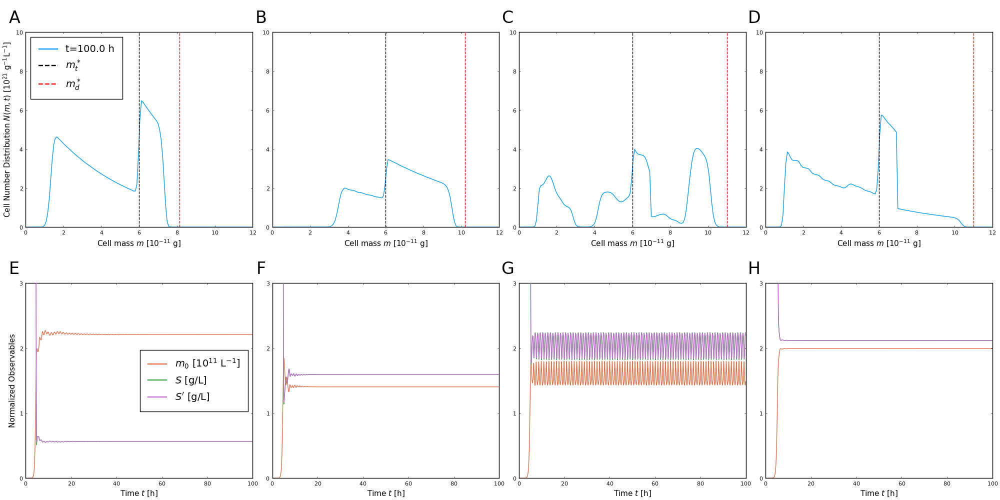

In [383]:
full_p

# First attempt at perturbing the IC to create a synchronous population was not successful. Need to deliver something more synchronous / non-overlapping. See D=0.4 1/h case above, final distribution of cells.

In [399]:
# attempt to step integrator manually, still using Julia
# https://docs.sciml.ai/DiffEqDocs/stable/basics/integrator/
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 100                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = N_00 .* N_pdf(mc,μ_0,σ_0)
S_0 = S_f
S_prime0 = S_0
m0 = N_00
u_0 = [
    S_0,                      # fig 4 initial substrate concentration [g/L]
    S_prime0,                 # fig 4 initial filtered substrate concentration [g/L]
    m0                        # from N_IC exact integration
]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 100.0                    # fig 4 final time [h]
tspan = (t0,tf)

# initialize to capture results for varying mesh size
# brute force scan over range D=0.0 1/h to D=1.0 1/h
N_m_list = 150 .* ones(Int,101)
D_varied = collect(range(0.0,1.0,101))
u_res = []
saved_val_times_list = []
parsed_N_mt_list = []
timings = []

for (j,N_m_test) in enumerate(N_m_list)
    
    # update your meshing and param vector
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)

    p_test_v2[19] = N_m_test    
    p_test_v2[20] = N_00 .* N_pdf(mc,μ_0,σ_0)
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))
    
    # pose the problem, no callbacks necessary, no saveat necessary (since controlling Δt)
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2,
        tstops = [20.0,50.0,100.0,130.0]
    )
    
    integrator = init(
        prob_openloop, 
        Rodas5(autodiff = false),
        reltol = 1e-8,
        abstol = 1e-8
    )
    
    # coupling time scale manually chosen
    # point is to decrease the amount of times at which coupling is forced
    # also cannot push the timestep too low as this will produce memory issues...
    Δt = 1.0e-2
    N_t = length(tspan[1]:Δt:tspan[2])
    times = Vector{Float64}(undef,N_t)
    parsed_N_mt = Matrix{Float64}(undef,N_t,N_m_test)
    u_list = Vector{Vector{Float64}}(undef,N_t)

    # sequentialism in solve, order of updates is control action, then PBM, then DAE system
    res_time = @elapsed begin 
        for (i,t) in enumerate(tspan[1]:Δt:tspan[2])

            # save some values for plotting, importantly time steps, 
            times[i] = integrator.t
            parsed_N_mt[i,:] = integrator.p[end-1]
            u_list[i] = copy(integrator.u)

            # update param vals for correct mesh
            integrator.p[9] = D_varied[j] # D_control(integrator.t)
            N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
                integrator.u[2],       # S′
                integrator.p[1:end-2], # p_PBE
                integrator.p[end-1],   # N_mt from previous timestamp
                Δt                     # dt for stepping PBM
            )
            integrator.p[end-1] = N_mt_res
            integrator.p[end] = Γm0_res
            OrdinaryDiffEq.step!(integrator, Δt, true)
        end
    end
    
    println("N_m=$(N_m_test) and D=$(D_varied[j]) 1/h completed in $(res_time)")
    
    # save all the necessary values
    push!(u_res, mapreduce(permutedims, vcat, u_list))
    push!(saved_val_times_list,times)
    push!(parsed_N_mt_list,parsed_N_mt)
    push!(timings,res_time)
    
end

N_m=150 and D=0.0 1/h completed in 539.2980962
N_m=150 and D=0.01 1/h completed in 511.1930452
N_m=150 and D=0.02 1/h completed in 566.798031
N_m=150 and D=0.03 1/h completed in 597.3854992
N_m=150 and D=0.04 1/h completed in 514.5229386
N_m=150 and D=0.05 1/h completed in 509.0787402
N_m=150 and D=0.06 1/h completed in 544.9579065
N_m=150 and D=0.07 1/h completed in 502.0652366
N_m=150 and D=0.08 1/h completed in 501.6741443
N_m=150 and D=0.09 1/h completed in 504.966284
N_m=150 and D=0.1 1/h completed in 502.6454572
N_m=150 and D=0.11 1/h completed in 504.2357752
N_m=150 and D=0.12 1/h completed in 505.7196308
N_m=150 and D=0.13 1/h completed in 502.9498032
N_m=150 and D=0.14 1/h completed in 505.5954752
N_m=150 and D=0.15 1/h completed in 501.8110508
N_m=150 and D=0.16 1/h completed in 505.1835191
N_m=150 and D=0.17 1/h completed in 526.6038407
N_m=150 and D=0.18 1/h completed in 504.7462444
N_m=150 and D=0.19 1/h completed in 510.7460929
N_m=150 and D=0.2 1/h completed in 502.83176

In [400]:
# Usage of file I/O via JLD.jl
jld_fp_figureplots = pwd() * "/openloop_D_varied_Nm_150_bifurcationD.jld"
# openloop_D_varied_Nm_150_bifurcationD = Dict{String, Vector}(
#     "params"=>p_test_v2,
#     "D_values"=>D_varied,
#     "solution_timepts"=>saved_val_times_list,
#     "state_values"=>u_res,
#     "cell_mass_distributions"=>parsed_N_mt_list,
#     "solution_wall_times"=>timings
# )

# # write
# jldopen(jld_fp_figureplots, "w") do file
#     write(file, "openloop_D_varied_Nm_150_bifurcationD", openloop_D_varied_Nm_150_bifurcationD)  # alternatively, say "@write file a"
# end

# # read
# openloop_D_varied_Nm_150_bifurcationD = jldopen(jld_fp_figureplots, "r") do file
#     read(file, "openloop_D_varied_Nm_150_bifurcationD")
# end
# display(openloop_D_varied_Nm_150_bifurcationD)

In [401]:
openloop_D_varied_Nm_150_bifurcationD

Dict{String, Vector} with 6 entries:
  "cell_mass_distributions" => Any[[4.9929e12 6.30673e12 … 0.00300535 0.0014722…
  "state_values"            => Any[[25.0 25.0 10000.0; 25.0 25.0 10000.4; … ; 1…
  "solution_wall_times"     => Any[539.298, 511.193, 566.798, 597.385, 514.523,…
  "D_values"                => [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, …
  "params"                  => Any[200.0, 2.82095e11, 0.1, 1.0e-13, 6.0e-11, 1.…
  "solution_timepts"        => Any[[0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.…

# Can do analysis of the above data to draw a simpler bifurcation plot

Most efficient way of checking if oscillations are occuring is to check the min and max of the most recent 10, 20, and 50 hours in each simulation. 

If the results for the min and max are the same for all times, the simulation is converged and has a steady state. 

If the results for the min and max are unequal at each time, but the inequality is the same for all times, the simulation is converged and has a sustained oscillations.

If the results for the min and max are unequal at all times, the simulation has probably not converged, and you should investigate those cases in more detail (most likely they are oscillatory and decaying to a stable attractor).

To be clear, you will compare the fluctuations in the zeroth moment (third state) and substrate levels (first state). Also need to consider numerical tolerances.

In [445]:
oscillatory_D_list = []
steady_D_list = []
unconverged_D_list = []
for (i,D_test) in enumerate(openloop_D_varied_Nm_150_bifurcationD["D_values"])
    println(D_test)
    N_t = length(openloop_D_varied_Nm_150_bifurcationD["solution_timepts"][i])
    mid_ind = Int(round(5/8*N_t))
    midmid_ind = Int(round(3/4*N_t))
    midmidmid_ind = Int(round(7/8*N_t))

    # compute the maxes
    max1_m0 = maximum(openloop_D_varied_Nm_150_bifurcationD["state_values"][i][mid_ind:end,3])
    max2_m0 = maximum(openloop_D_varied_Nm_150_bifurcationD["state_values"][i][midmid_ind:end,3])
    max3_m0 = maximum(openloop_D_varied_Nm_150_bifurcationD["state_values"][i][midmidmid_ind:end,3])
    
    # compute the mins
    min1_m0 = minimum(openloop_D_varied_Nm_150_bifurcationD["state_values"][i][mid_ind:end,3])
    min2_m0 = minimum(openloop_D_varied_Nm_150_bifurcationD["state_values"][i][midmid_ind:end,3])
    min3_m0 = minimum(openloop_D_varied_Nm_150_bifurcationD["state_values"][i][midmidmid_ind:end,3])
    
    if i==2
        println(
            min1_m0,"\n",
            max1_m0,"\n",
            min2_m0,"\n",
            max2_m0,"\n",
            min3_m0,"\n",
            max3_m0,"\n"
        )
    end
    
    # test redundancy in values with sets (which remove non-unique duplicates)
    check_duplicates = Set([max1_m0,max2_m0,max3_m0,min1_m0,min2_m0,min3_m0])
    
    # case for all duplicates (steady state, quick convergence)
    if length(check_duplicates) == 1
        push!(steady_D_list,i)
    # case for two sets of duplicates, one for min, one for max
    # can extend to 4 elements if min and max repeated twice, but mid_ind was still not converged
    elseif length(check_duplicates)==2 || length(check_duplicates)==4
        push!(oscillatory_D_list,i)
    
    # catch all for unconverged / edge case simulations
    else
        push!(unconverged_D_list,i)
    end
end

0.0
0.01
2.554536830049681e11
2.649241460591255e11
2.5903799322013934e11
2.649241460591255e11
2.5903799322013934e11
2.6160688813761758e11

0.02
0.03
0.04
0.05
0.06
0.07
0.08
0.09
0.1
0.11
0.12
0.13
0.14
0.15
0.16
0.17
0.18
0.19
0.2
0.21
0.22
0.23
0.24
0.25
0.26
0.27
0.28
0.29
0.3
0.31
0.32
0.33
0.34
0.35
0.36
0.37
0.38
0.39
0.4
0.41
0.42
0.43
0.44
0.45
0.46
0.47
0.48
0.49
0.5
0.51
0.52
0.53
0.54
0.55
0.56
0.57
0.58
0.59
0.6
0.61
0.62
0.63
0.64
0.65
0.66
0.67
0.68
0.69
0.7
0.71
0.72
0.73
0.74
0.75
0.76
0.77
0.78
0.79
0.8
0.81
0.82
0.83
0.84
0.85
0.86
0.87
0.88
0.89
0.9
0.91
0.92
0.93
0.94
0.95
0.96
0.97
0.98
0.99
1.0


In [477]:
oscillatory_D_list
# steady_D_list
# unconverged_D_list

35-element Vector{Any}:
  2
  3
  4
  5
  6
  7
 32
 33
 39
 40
 41
 42
 53
  ⋮
 72
 76
 80
 82
 84
 87
 88
 89
 91
 96
 98
 99

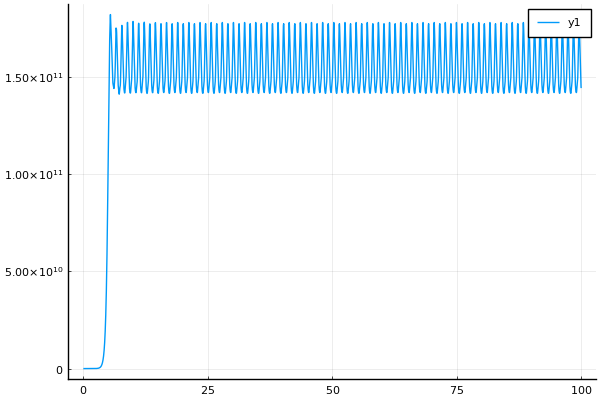

In [476]:
k = 65
times = openloop_D_varied_Nm_150_bifurcationD["solution_timepts"][k]
m0_states = openloop_D_varied_Nm_150_bifurcationD["state_values"][k][:,3]
plot(
    times,
    m0_states
)

# Can produce results for a synchronized cell culture initiation to test arguments of cell synchrony

In [ ]:
# read
openloop_D_varied_Nm_150_lowD = jldopen(jld_fp_lowD, "r") do file
    read(file, "openloop_D_varied_Nm_150_lowD")
end
display(openloop_D_varied_Nm_150_lowD)

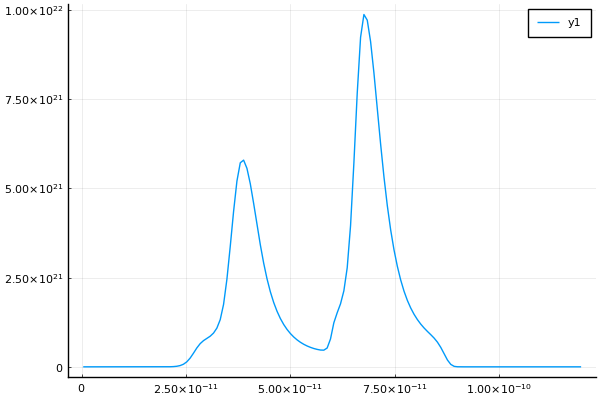

In [480]:
# find the synchronized distribution
N_m_test = 150
m_edges = collect(range(0.0,m_max,N_m_test+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
plot(
    mc,
    openloop_D_varied_Nm_150_lowD["cell_mass_distributions"][3][end,:]
)

In [494]:
# attempt to step integrator manually, still using Julia
# https://docs.sciml.ai/DiffEqDocs/stable/basics/integrator/
# helper functions
N_pdf(x::Union{AbstractFloat,AbstractArray}, mu::AbstractFloat, sigma::AbstractFloat) = @. 1/sigma/sqrt(2*pi) * exp( -(x - mu)^2 / 2 / sigma^2) # normal distribution for h(x) or h(m) depending on whether (x,mu_x,sigma_x) or (m,mu_m,sigma_m) are fed

# params
γ = 200.0                     # 1) 1/hr, maximum fission rate, when cell m ≥ m_d
A = sqrt(25/π)*1.0e11         # 2) 1/g, partition function exponential prefactors (i.e., p(m,m'))
S_l = 0.1                     # 3) g/L, low substrate limit
K_t = 0.01e-11                # 4) g/g/L, proportionality constant for change in transition mass with substrate levels
m_t0 = 6.0e-11                # 5) g, initial transition mass (at low substrate levels)
m_max = 12.0e-11              # 6) g, maximal cell mass allowed
Y = 0.4                       # 7) g/g, yield coefficient for cell mass to mols substrate
K_m = 25.0                    # 8) g/L, Monod constant for single cell growth rate
D = 0.25                      # 9) 1/h, dilution rate in continuous bioreactor operation
ϵ = 5.0e22                    # 10) g^{-2}, inverse variance for fission rate when cells are in fissioning state
β = 100.0e22                  # 11) g^{-2}, another inverse variance for partition function
S_h = 2.0                     # 12) g/L, high substrate limit
K_d = 2.0e-11                 # 13) g/g/L, proportionality constant for change in critical fissioning mass with substrate levels
m_d0 = 11.0e-11               # 14) g, initial critical fissioning mass (at low substrate levels)
m_a = 1.0e-11                 # 15) g, additional mass that mother cell must gain to start fissioning
μ_m = 5.0e-10                 # 16) g/h, single cell growth rate in limit of high substrate levels
α = 20.0                      # 17) 1/h, rate constant for delayed adjustment of cell metabolism to substrate levels
S_f = 25.0                    # 18) g/L, feed concentration of substrate to continuous bioreactor
N_m = 150                     # 19) -, number of grid points in mass domain

# IC conditions
μ_0 = 3.0e-11                 # g, initial cell mass distribution mean
σ_0 = 1.0e-11                 # g, initial cell mass distribution standard deviation
N_00 = 1.0e4                  # -, initial total number of cells
m_edges = collect(range(0.0,m_max,N_m+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
N_IC = openloop_D_varied_Nm_150_lowD["cell_mass_distributions"][3][end,:]
u_0 = openloop_D_varied_Nm_150_lowD["state_values"][3][end,:]

S_0 = u_0[1]
S_prime0 = u_0[2]
m0 = u_0[3]
m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)
Γ0m0 = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (N_IC .* Γ0))

p_test_v2 = [
    γ,
    A,
    S_l,
    K_t,
    m_t0,
    m_max,
    Y,
    K_m,
    D,
    ϵ,
    β,
    S_h,
    K_d,
    m_d0,
    m_a,
    μ_m,
    α,
    S_f,
    N_m,
    N_IC,
    Γ0m0
]

# numerical parameters and ICs
t0 = 0.0                      # fig 4 initial time [h]
tf = 10.0                    # fig 4 final time [h]
tspan = (t0,tf)

# initialize to capture results for varying mesh size
# brute force scan over range D=0.0 1/h to D=1.0 1/h
N_m_list = 150 .* ones(Int,101)
D_varied = collect(range(0.0,1.0,101))
u_res = []
saved_val_times_list = []
parsed_N_mt_list = []
timings = []

for (j,N_m_test) in enumerate(N_m_list)
    
    # update your meshing and param vector
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    m_t_test = py"m_td"(S_prime0, m_t0, K_t, S_l, S_h)
    m_d_test = py"m_td"(S_prime0, m_d0, K_d, S_l, S_h)
    Γ0 =py"Γ"(mc,γ,ϵ,m_t_test,m_d_test,m_a)

    p_test_v2[19] = N_m_test    
    p_test_v2[20] = openloop_D_varied_Nm_150_lowD["cell_mass_distributions"][3][end,:]
    p_test_v2[21] = py"midpt_trapz"((mc[2] - mc[1]) .* ones(length(mc)), (p_test_v2[20] .* Γ0))
    
    # pose the problem, no callbacks necessary, no saveat necessary (since controlling Δt)
    prob_openloop = ODEProblem(
        substrateODEs_v2!,
        u_0,
        tspan,
        p_test_v2
    )
    
    integrator = init(
        prob_openloop, 
        Rodas5(autodiff = false),
        reltol = 1e-8,
        abstol = 1e-8
    )
    
    # coupling time scale manually chosen
    # point is to decrease the amount of times at which coupling is forced
    # also cannot push the timestep too low as this will produce memory issues...
    Δt = 1.0e-2
    N_t = length(tspan[1]:Δt:tspan[2])
    times = Vector{Float64}(undef,N_t)
    parsed_N_mt = Matrix{Float64}(undef,N_t,N_m_test)
    u_list = Vector{Vector{Float64}}(undef,N_t)

    # sequentialism in solve, order of updates is control action, then PBM, then DAE system
    res_time = @elapsed begin 
        for (i,t) in enumerate(tspan[1]:Δt:tspan[2])

            # save some values for plotting, importantly time steps, 
            times[i] = integrator.t
            parsed_N_mt[i,:] = integrator.p[end-1]
            u_list[i] = copy(integrator.u)

            # update param vals for correct mesh
            integrator.p[9] = D_varied[j] # D_control(integrator.t)
            N_mt_res, Γm0_res = py"step_yeast_PBM_v2"(
                integrator.u[2],       # S′
                integrator.p[1:end-2], # p_PBE
                integrator.p[end-1],   # N_mt from previous timestamp
                Δt                     # dt for stepping PBM
            )
            integrator.p[end-1] = N_mt_res
            integrator.p[end] = Γm0_res
            OrdinaryDiffEq.step!(integrator, Δt, true)
        end
    end
    
    println("N_m=$(N_m_test) and D=$(D_varied[j]) 1/h completed in $(res_time)")
    
    # save all the necessary values
    push!(u_res, mapreduce(permutedims, vcat, u_list))
    push!(saved_val_times_list,times)
    push!(parsed_N_mt_list,parsed_N_mt)
    push!(timings,res_time)
    
end

N_m=150 and D=0.0 1/h completed in 49.0120376
N_m=150 and D=0.01 1/h completed in 51.1463561
N_m=150 and D=0.02 1/h completed in 47.1664019
N_m=150 and D=0.03 1/h completed in 43.7322031
N_m=150 and D=0.04 1/h completed in 43.0544332
N_m=150 and D=0.05 1/h completed in 43.4993766
N_m=150 and D=0.06 1/h completed in 44.7435363
N_m=150 and D=0.07 1/h completed in 46.7504773
N_m=150 and D=0.08 1/h completed in 52.0520106
N_m=150 and D=0.09 1/h completed in 46.8236495
N_m=150 and D=0.1 1/h completed in 52.809454
N_m=150 and D=0.11 1/h completed in 46.9757752
N_m=150 and D=0.12 1/h completed in 44.4416052
N_m=150 and D=0.13 1/h completed in 46.042842
N_m=150 and D=0.14 1/h completed in 50.9694314
N_m=150 and D=0.15 1/h completed in 53.3763646
N_m=150 and D=0.16 1/h completed in 50.8807932
N_m=150 and D=0.17 1/h completed in 48.4606928
N_m=150 and D=0.18 1/h completed in 54.2733048
N_m=150 and D=0.19 1/h completed in 50.1804405
N_m=150 and D=0.2 1/h completed in 46.915562
N_m=150 and D=0.21 

In [569]:
saved_val_times_list=openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC["solution_timepts"]
u_res=openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC["state_values"]
parsed_N_mt_list=openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC["cell_mass_distributions"]
D_varied=openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC["D_values"]

101-element Vector{Float64}:
 0.0
 0.01
 0.02
 0.03
 0.04
 0.05
 0.06
 0.07
 0.08
 0.09
 0.1
 0.11
 0.12
 ⋮
 0.89
 0.9
 0.91
 0.92
 0.93
 0.94
 0.95
 0.96
 0.97
 0.98
 0.99
 1.0

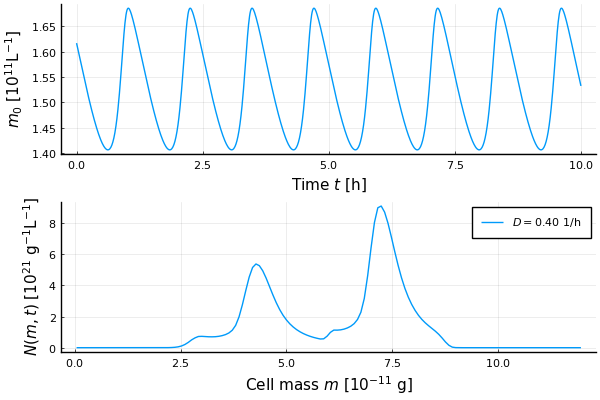

In [581]:
# check m0 in time
k=41
p1 = plot(
    saved_val_times_list[k],
    u_res[k][:,3] ./ 1.0e11,
    label="",
    xlabel = L"Time $t$ [h]",
    ylabel = L"$m_0$ [$10^{11}$L$^{-1}$]"
)

# check changes in synchronous distribution?
N_m_test = 150
m_edges = collect(range(0.0,m_max,N_m_test+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
p2 = plot(
    mc ./ 1.0e-11,
    parsed_N_mt_list[k][end,:] ./ 1.0e21,
    label= L"$D=0.40$ 1/h",
    xlabel = L"Cell mass $m$ [$10^{-11}$ g]",
    ylabel = L"$N(m,t)$ [$10^{21}$ g$^{-1}$L$^{-1}$]",
)

plot(p1,p2,layout=(2,1))

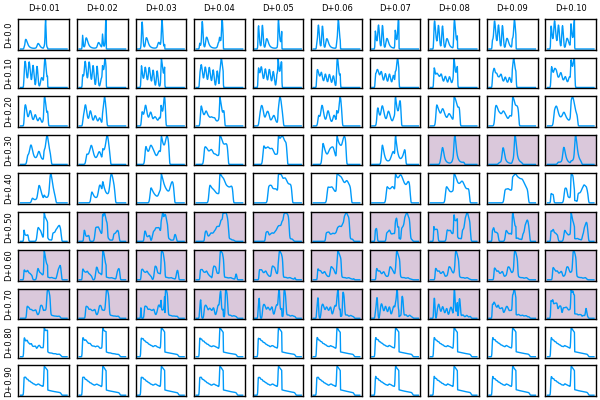

In [545]:
# https://docs.juliaplots.org/latest/generated/colorschemes/
shade_col = palette(:acton10)[9]
canvas_p_N_mt = []
for (j,D_test) in enumerate(D_varied[2:end])
    j=j+1
    N_m_test = 150
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    
    p = plot(
        mc,
        parsed_N_mt_list[j][end,:],
        label = "",
        grid=false,
        ticks = false,
        framestyle = :box
    )
    
    if j in [2,12,22,32,42,52,62,72,82,92]
        plot!(
            p,
            ylabel = "D+0.$(j-2)",
            labelfontsize = 6
        )
    end
    
    if j in [2,3,4,5,6,7,8,9,10,11]
        plot!(
            p,
            title = ifelse(j!=11,"D+0.0$(j-1)","D+0.$(j-1)"),
            titlefontsize = 6
        )
    end
    
    if j in vcat([39,40,41],collect(53:1:81))
        plot!(
            p,
            background_color_subplot = shade_col
        )
    end
    
    push!(canvas_p_N_mt,p)
end
full_canvas_p = plot(
    canvas_p_N_mt...,
    layout = (10,10)
)

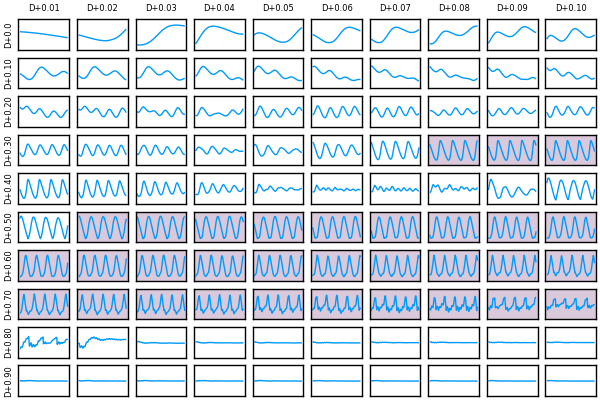

In [576]:
# https://docs.juliaplots.org/latest/generated/colorschemes/
shade_col = palette(:acton10)[9]
canvas_p_oscillations = []
for (j,D_test) in enumerate(D_varied[2:end])
    j=j+1
    N_m_test = 150
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    last5hours_ind = 501 # 5001 #9001
    min_ylim = minimum(u_res[j][last5hours_ind:end,3])
    max_ylim = maximum(u_res[j][last5hours_ind:end,3])
    
    p = plot(
        saved_val_times_list[j][last5hours_ind:end],# last10hours_ind:end
        u_res[j][last5hours_ind:end,3],
        label = "",
        grid=false,
        ticks = false,
        framestyle = :box,
        ylim = (min_ylim*0.95, max_ylim*1.05)
    )
    
    if j in [2,12,22,32,42,52,62,72,82,92]
        plot!(
            p,
            ylabel = "D+0.$(j-2)",
            labelfontsize = 6
        )
    end
    
    if j in [2,3,4,5,6,7,8,9,10,11]
        plot!(
            p,
            title = ifelse(j!=11,"D+0.0$(j-1)","D+0.$(j-1)"),
            titlefontsize = 6
        )
    end
    
    if j in vcat([39,40,41],collect(53:1:81))
        plot!(
            p,
            background_color_subplot = shade_col
        )
    end
    
    push!(canvas_p_oscillations,p)
end
plot(
    canvas_p_oscillations...,
    layout = (10,10)
)

In [546]:
# Usage of file I/O via JLD.jl
jld_fp_figureplots = pwd() * "/openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC.jld"
# openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC = Dict{String, Vector}(
#     "params"=>p_test_v2,
#     "D_values"=>D_varied,
#     "solution_timepts"=>saved_val_times_list,
#     "state_values"=>u_res,
#     "cell_mass_distributions"=>parsed_N_mt_list,
#     "solution_wall_times"=>timings
# )

# # write
# jldopen(jld_fp_figureplots, "w") do file
#     write(file, "openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC", openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC)  # alternatively, say "@write file a"
# end

# # read
# openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC = jldopen(jld_fp_figureplots, "r") do file
#     read(file, "openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC")
# end
# display(openloop_D_varied_Nm_150_bifurcationD_TwoPeakIC)

# Make the same canvas plots with previous one Gaussian peak simulations

In [547]:
# # Usage of file I/O via JLD.jl
# jld_fp_figureplots = pwd() * "/openloop_D_varied_Nm_150_bifurcationD.jld"

# # read
# openloop_D_varied_Nm_150_bifurcationD = jldopen(jld_fp_figureplots, "r") do file
#     read(file, "openloop_D_varied_Nm_150_bifurcationD")
# end
# # display(openloop_D_varied_Nm_150_bifurcationD)

LoadError: InterruptException:

In [552]:
openloop_D_varied_Nm_150_bifurcationD

Dict{String, Vector} with 6 entries:
  "cell_mass_distributions" => Any[[4.9929e12 6.30673e12 … 0.00300535 0.0014722…
  "state_values"            => Any[[25.0 25.0 10000.0; 25.0 25.0 10000.4; … ; 1…
  "solution_wall_times"     => Any[539.298, 511.193, 566.798, 597.385, 514.523,…
  "D_values"                => [0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, …
  "params"                  => Any[200.0, 2.82095e11, 0.1, 1.0e-13, 6.0e-11, 1.…
  "solution_timepts"        => Any[[0.0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.…

In [553]:
saved_val_times_list=openloop_D_varied_Nm_150_bifurcationD["solution_timepts"]
u_res=openloop_D_varied_Nm_150_bifurcationD["state_values"]
parsed_N_mt_list=openloop_D_varied_Nm_150_bifurcationD["cell_mass_distributions"]
D_varied=openloop_D_varied_Nm_150_bifurcationD["D_values"]

101-element Vector{Float64}:
 0.0
 0.01
 0.02
 0.03
 0.04
 0.05
 0.06
 0.07
 0.08
 0.09
 0.1
 0.11
 0.12
 ⋮
 0.89
 0.9
 0.91
 0.92
 0.93
 0.94
 0.95
 0.96
 0.97
 0.98
 0.99
 1.0

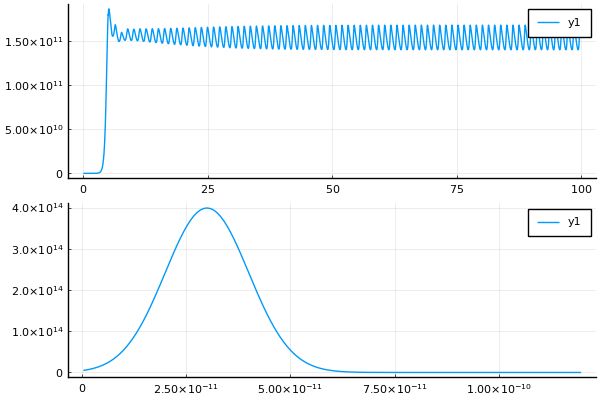

In [551]:
# check m0 in time
k=41
p1 = plot(
    saved_val_times_list[k],
    u_res[k][:,3]
)

# check changes in synchronous distribution?
N_m_test = 150
m_edges = collect(range(0.0,m_max,N_m_test+1))
mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
p2 = plot(
    mc,
    parsed_N_mt_list[k][1,:]
)

plot(p1,p2,layout=(2,1))

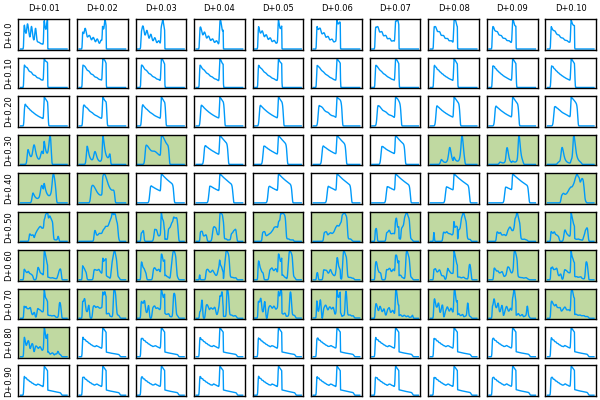

In [568]:
# https://docs.juliaplots.org/latest/generated/colorschemes/
# take last 10 hours of converged results to have 1:1 with 2peak results
shade_col = palette(:bam10)[7]
canvas_p_N_mt = []
for (j,D_test) in enumerate(D_varied[2:end])
    j=j+1
    N_m_test = 150
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    last10hours_ind = 9001
    
    p = plot(
        mc,
        parsed_N_mt_list[j][end,:],
        label = "",
        grid=false,
        ticks = false,
        framestyle = :box
    )
    
    if j in [2,12,22,32,42,52,62,72,82,92]
        plot!(
            p,
            ylabel = "D+0.$(j-2)",
            labelfontsize = 6
        )
    end
    
    if j in [2,3,4,5,6,7,8,9,10,11]
        plot!(
            p,
            title = ifelse(j!=11,"D+0.0$(j-1)","D+0.$(j-1)"),
            titlefontsize = 6
        )
    end
    
    if j in vcat([32,33,34,39,40,41,42,43],collect(51:1:82))
        plot!(
            p,
            background_color_subplot = shade_col
        )
    end
    
    push!(canvas_p_N_mt,p)
end
full_canvas_p = plot(
    canvas_p_N_mt...,
    layout = (10,10)
)

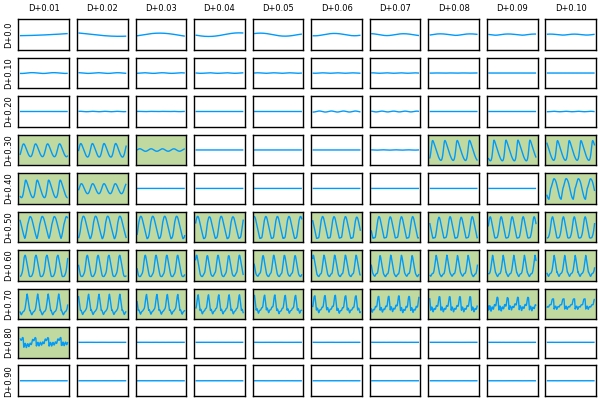

In [567]:
# https://docs.juliaplots.org/latest/generated/colorschemes/
shade_col = palette(:bam10)[7]
canvas_p_oscillations = []
for (j,D_test) in enumerate(D_varied[2:end])
    j=j+1
    N_m_test = 150
    m_edges = collect(range(0.0,m_max,N_m_test+1))
    mc = ((m_edges[2] - m_edges[1]) / 2.0) .+ m_edges[1:end-1]
    last5hours_ind = 9501 # 5001 #9001
    min_ylim = minimum(u_res[j][last5hours_ind:end,3])
    max_ylim = maximum(u_res[j][last5hours_ind:end,3])
    
    p = plot(
        saved_val_times_list[j][last5hours_ind:end],# last10hours_ind:end
        u_res[j][last5hours_ind:end,3],
        label = "",
        grid=false,
        ticks = false,
        framestyle = :box,
        ylim = (min_ylim*0.95, max_ylim*1.05)
    )
    
    if j in [2,12,22,32,42,52,62,72,82,92]
        plot!(
            p,
            ylabel = "D+0.$(j-2)",
            labelfontsize = 6
        )
    end
    
    if j in [2,3,4,5,6,7,8,9,10,11]
        plot!(
            p,
            title = ifelse(j!=11,"D+0.0$(j-1)","D+0.$(j-1)"),
            titlefontsize = 6
        )
    end
    
    if j in vcat([32,33,34,39,40,41,42,43],collect(51:1:82))
        plot!(
            p,
            background_color_subplot = shade_col
        )
    end
    
    push!(canvas_p_oscillations,p)
end
plot(
    canvas_p_oscillations...,
    layout = (10,10)
)